<a href="https://colab.research.google.com/github/sdesena/above-ground-biomass-machine-learning/blob/main/AGB_Modeling_and_Mapping.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Environment setting


In [1]:

# Libraries instalation

# Libraries to manipulate and visualize data
!pip install -U seaborn -q
!pip install plotly -q
!pip install geopandas -q
!pip install fireducks -q
!pip install pandas -q
!pip install matplotlib -q
!pip install numpy -q

# Libraries to manipulate geospatial data
!pip install rasterio -q
!pip install earthpy -q
!pip install sankee -q

# Libraries for statistical analysis and modeling
!pip install scipy -q
!pip install scikit-learn -q
!pip install pingouin -q
!pip install xgboost -q
!pip install keras -q
!pip install tensorflow -q
!pip install keras-tuner
!pip install shap -q
!pip install bayesian-optimization -q


In [2]:
# Libraries import

# Earth Engine API
import ee
import geemap
import json

# Manipulation and visualization
import geopandas as gpd

# import pandas as pd
import fireducks.pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
from scipy.stats import skew, kurtosis

# Geospatial data manipulation
import rasterio
import earthpy.plot as ep
import sankee

# Modeling and evaluation
import itertools
import xgboost
import keras
import keras_tuner as kt
import pingouin as pg
import shap
from scipy.stats import mannwhitneyu


In [3]:
# Pre-processing
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder  # Transformação de dados
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler

# Machine learning models
from sklearn.model_selection import KFold  # Cross-validation
from sklearn.model_selection import train_test_split  # Divisão dos dados em treino e teste
from sklearn.ensemble import RandomForestRegressor  # Regressão com Floresta Aleatória
from sklearn.linear_model import LinearRegression  # Regressão Linear

# Models evaluation
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, root_mean_squared_error  # Métricas de regressão
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GroupKFold
from sklearn.model_selection import cross_val_score

# Feature importance
from sklearn.inspection import permutation_importance  # Importância por permutação

# Deep learning
from keras import Sequential  # Modelo sequencial
from keras.layers import Dense, Dropout, Input  # Camadas de rede neural
from keras.callbacks import EarlyStopping  # Regularização com parada antecipada
from keras import Model  # Modelos mais flexíveis
from keras.utils import to_categorical, plot_model  # Utilidades para redes neurais

# Hyper-parameters optimization
from bayes_opt import BayesianOptimization  # Otimização Bayesiana
from keras.optimizers import Adam  # Otimizadores
from keras.metrics import RootMeanSquaredError
from keras_tuner.tuners import RandomSearch  # Otimização de hiperparâmetros
from keras_tuner.engine.hyperparameters import HyperParameters  # Otimização de hiperparâmetros

# Manipulation and visualization of raster data
from rasterio.plot import show  # Visualização de dados raster

In [4]:
# Authenticate and initialize Google cloud project
ee.Authenticate()
ee.Initialize(project='ee-sandrosenamachado')

*** Earth Engine *** Share your feedback by taking our Annual Developer Satisfaction Survey: https://google.qualtrics.com/jfe/form/SV_0JLhFqfSY1uiEaW?source=Init


In [5]:
# Set up Google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 1. Area of Interest (AOI)
> The Mangueirinha Indigenous Land was chosen as the study area due to the quality, consistency, and relevance of available field-collected Aboveground Biomass (AGB) data. This area features representative sampling and well-established partnerships for data collection and analysis, providing a reliable ground truth dataset for 2015. This dataset is essential for calibrating and validating the models.

* Located in western Paraná within the Iguaçu River basin, the Mangueirinha Indigenous Land is highlighted in the National Forest Inventory (NFI) technical report. The report includes data on forest health and vitality, biodiversity, biomass, and carbon stocks, as well as socio-environmental information.

> To delineate the study area, administrative boundary data were sourced in shapefile format from the MapBiomas layers table, with FUNAI as the primary source. This data must then be converted into JSON format to be integrated into the Google Earth Engine as a feature collection.


MapBiomas is a satellite imagery-based mapping platform that monitors land use and cover over time. For the Mangueirinha Indigenous Land, it enables historical analysis of land use changes, identifying patterns of deforestation, forest regeneration, and agricultural expansion. The tool is invaluable for monitoring pressures on the territory, evaluating major transformations over the decades, and supporting environmental management and the preservation of indigenous land.

In [6]:
# Load shapefile data
gdf = gpd.read_file('/content/drive/MyDrive/Geoprocessamento/GIS Data/Terras indígenas/dashboard_indigenous-lands-static-layer.shp')

# Check data structure and dimensions
gdf.head()

,id,version,name,source,inserted_a,updated_at,category,category_n,area_ha,geometry
0,12618,1,Mato Castelhano,FUNAI,2020-02-07,2020-02-07,indigenous_land,Terra Indígena,3569.67303,"POLYGON ((-52.17715 -28.34522, -52.17723 -28.3..."
1,12619,1,Mato Preto,FUNAI,2020-02-07,2020-02-07,indigenous_land,Terra Indígena,4232.18007,"POLYGON ((-52.25868 -27.78328, -52.18658 -27.7..."
2,12620,1,Mawetek,FUNAI,2020-02-07,2020-02-07,indigenous_land,Terra Indígena,115527.67786,"POLYGON ((-69.99875 -6.70515, -69.99985 -6.703..."
3,14270,1,Cachoeira dos InOcios,FUNAI,2020-02-07,2020-02-07,indigenous_land,Terra Indígena,81.38464,"POLYGON ((-48.80004 -28.17988, -48.7977 -28.17..."
4,14275,1,Cachoeira Seca,FUNAI,2020-02-07,2020-02-07,indigenous_land,Terra Indígena,732447.51518,"POLYGON ((-53.40379 -3.90833, -53.40417 -3.909..."


<Axes: >

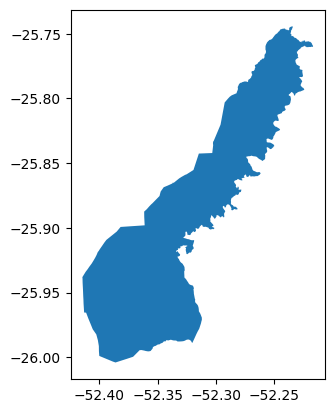

In [7]:
# Select relevant features
gdf = gdf[['id','name','area_ha','geometry']]

# Filter features per attribute
aoi_shp = gdf[gdf['name']=='Mangueirinha']

# Plot the shape
aoi_shp.plot()


In [8]:
# Check attributes
aoi_shp.head()

,id,name,area_ha,geometry
396,15117,Mangueirinha,17246.73911,"POLYGON ((-52.28217 -25.796, -52.28207 -25.795..."


In [9]:
# Transform shapefile to JSON
shp_json = aoi_shp.to_json()

# Load JSON file
aoi = json.loads(shp_json)

# Select features
aoi = aoi['features']


In [10]:
# Create a feature collection with the JSON
region = ee.FeatureCollection(aoi)

In [11]:
# # Saving the JSON and SHP file
# gdf.to_file("aoi.json", driver='GeoJSON')
# gdf.to_file("aoi.shp")

In [12]:
# Add feature to de map and draw its contours

# Instaciate geepmap display function (Map)
Map = geemap.Map()

# Draw AOI contour
image_region = ee.Image().paint(region, 0, 2)

# Add layer
Map.addLayer(image_region,{'palette':'red'}, 'AOI')

# Centralize AOI
Map.centerObject(region,10)

# Set basemap
Map.set_options('HYBRID')

# Call Map funciton
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

## MapBiomas - Land Use and Land Cover (LULC)

In [13]:
# Get MapBiomas collections asset on Google Earth Engine catalog
path_project = 'projects/mapbiomas-public/assets/brazil/lulc/collection7/mapbiomas_collection70_integration_v2'

# Create an image object with the path
mapbiomas = ee.Image(path_project)
print('Dados MapBiomas',mapbiomas.bandNames().getInfo())


Dados MapBiomas ['classification_1985', 'classification_1986', 'classification_1987', 'classification_1988', 'classification_1989', 'classification_1990', 'classification_1991', 'classification_1992', 'classification_1993', 'classification_1994', 'classification_1995', 'classification_1996', 'classification_1997', 'classification_1998', 'classification_1999', 'classification_2000', 'classification_2001', 'classification_2002', 'classification_2003', 'classification_2004', 'classification_2005', 'classification_2006', 'classification_2007', 'classification_2008', 'classification_2009', 'classification_2010', 'classification_2011', 'classification_2012', 'classification_2013', 'classification_2014', 'classification_2015', 'classification_2016', 'classification_2017', 'classification_2018', 'classification_2019', 'classification_2020', 'classification_2021']


In [14]:
# Palette MapBiomas - https://mapbiomas-br-site.s3.amazonaws.com/downloads/_EN__C%C3%B3digos_da_legenda_Cole%C3%A7%C3%A3o_7.pdf
palette_list = ['#ffffff','#129912','#1f4423','#006400','#00ff00','#687537','#76a5af','#29eee4',
'#77a605','#ad4413','#bbfcac','#45c2a5','#b8af4f','#f1c232','#ffffb2','#ffd966',
'#f6b26b','#f99f40','#e974ed','#d5a6bd','#c27ba0','#fff3bf','#ea9999','#dd7e6b',
'#aa0000','#ff8585','#0000ff','#d5d5e5','#dd497f','#665a3a','#ff0000','#1f0478',
'#968c46','#0000ff','#4fd3ff','#ba6a27','#f3b4f1','#02106f','#02106f','#e075ad',
'#982c9e','#e787f8','#ebebe0','#c2c2a3','#6b6b47','#d0ffd0','#cca0d4','#d082de',
'#cd49e4','#6b9932','#66ffcc','#000000','#000000','#000000','#000000','#000000',
'#000000','#CC66FF','#FF6666','#006400','#8d9e8b','#84ff75','#faf87d']

In [15]:
# Mapbiomas layer
map_1985 = mapbiomas.select('classification_1985')
map_2021 = mapbiomas.select('classification_2021')

# Show it on the display
Map.addLayer(map_1985, {'palette':palette_list, 'min':0, 'max':62},'1985')
Map.addLayer(map_2021, {'palette':palette_list, 'min':0, 'max':62},'2021')

Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [16]:
# Clip images by the feature collection
reg_1985 = map_1985.clip(region)
reg_2021 = map_2021.clip(region)

# Visualize the cliped layers
Map.addLayer(reg_1985,{'palette':palette_list, 'min':0,'max':62},'Mangueirinha 1985')
Map.addLayer(reg_2021,{'palette':palette_list, 'min':0,'max':62},'Mangueirinha 2021')

# Show
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [17]:
# Calculate class areas
# Legend source < https://mapbiomas-br-site.s3.amazonaws.com/downloads/_EN__C%C3%B3digos_da_legenda_Cole%C3%A7%C3%A3o_7.pdf >
# Urban_Area= 24
# Forest = 1

# Loop to create an image collection from the MapBiomas bands
lista = ee.List.sequence(0, 36)  # Sequence representing band indices for the years of interest
years = ee.List.sequence(1985, 2021)  # Sequence of years corresponding to the MapBiomas dataset

# Function to map each band index to an image with metadata
def collection_image(number):
    # Retrieve the band name corresponding to the given index
    matchKey = ee.String(ee.List(mapbiomas.bandNames()).get(number))

    # Select the image corresponding to the band name
    image = ee.Image(mapbiomas).select(matchKey)

    # Add metadata attributes to the image

    # Assign year metadata for easier filtering
    return image.set('year', years.get(number))\
                  .set('system:time_start', ee.Date.fromYMD(years.get(number), 1, 1))\
                    .clip(region)

# Apply the function across the list of indices to generate individual images with metadata
listImages = lista.map(collection_image)

# Convert the list of images into an ImageCollection for further processing
imageCollection = ee.ImageCollection.fromImages(listImages)

# Output the size of the generated ImageCollection
print('Image Collection size:', imageCollection.size().getInfo())




Image Collection size: 37


In [18]:
# Check bands names
imageCollection.first().bandNames()

In [19]:
# Count the number of images in the ImageCollection
count = imageCollection.size().getInfo()  # Retrieve the size of the ImageCollection and convert it to a Python variable

# Extract the list of years used for the ImageCollection
year_list = years.getInfo()  # Convert the Earth Engine list of years to a Python list

# Extract the list of indices corresponding to the bands
lista_list = lista.getInfo()  # Convert the Earth Engine list of band indices to a Python list


In [20]:
# Create a dictionary for LULC classes
dicionario_classes = {
    0:"Fora da área de interesse", 1:"Floresta", 3:"Formação Florestal",
    4:"Formação Savânica", 5:"Mangue", 49:"Restinga Arborizada",  10:"Formação Natural não Florestal",
    11:"Campo Alagado e Área Pantanosa",   12:"Formação Campestre",
    32:"Apicum",   29:"Afloramento Rochoso",   50:"Restinga Herbácea",
    13:"Outras Formações não Florestais",  14:"Agropecuária",
    15:"Pastagem",   18:"Agricultura",
    19:"Lavoura Temporária",   39:"Soja",
    20:"Cana",   40:"Arroz (beta)",   62:"Algodão (beta)",
    41:"Outras Lavouras Temporárias", 36:"Lavoura Perene",  46:"Café",
    47:"Citrus",  48:"Outras Lavouras Perenes",  9:"Silvicultura",
    21:"Mosaico de Usos",  22:"Área não Vegetada",  23:"Praia, Duna e Areal",
    24:"Área Urbanizada",  30:"Mineração", 25:"Outras Áreas não Vegetadas",
    26:"Corpo D'água", 33:"Rio, Lago e Oceano",
    31:"Aquicultura", 27:"Não observado"
}

# Create a palette dictionary
dicionario_cores = {
    0:"white", 1:"#129912",
    3:"#006400", 4:"#00ff00",
    5:"#687537", 49:"#6b9932",
    10:"#bbfcac", 11:"#45c2a5",
    12:"#b8af4f", 32:"#968c46",
    29:"#ff8C00", 50:"#66ffcc",
    13:"#bdb76b",
    14:"#ffffb2",
    15:"#ffd966",
    18:"#e974ed",
    19:"#d5a6bd",
    39:"#c59ff4",
    20:"#c27ba0",
    40:"#982c9e",
    62:"#660066",
    41:"#e787f8",
    36:"#f3b4f1",
    46:"#cca0d4",
    47:"#d082de",
    48:"#cd49e4",
    9:"#935132",
    21:"#fff3bf",
    22:"#ea9999",
    23:"#dd7e6b",
    24:"#af2a2a",
    30:"#8a2be2",
    25:"#ff99ff",
    26:"#0000ff",
    33:"#0000ff",
    31:"#29eee4",
    27:"#D5D5E5"
}

# Join dictionaries with the keys
paleta_nomes = {key:value for key, value in zip(dicionario_classes.values(), dicionario_cores.values())}

In [21]:
# Opening all images and calculating the area for each
# Create an empty list to store the resulting DataFrames
df = []

# Loop through images in intervals (e.g., every 5 years)
for i in range(0, count, 5):  # Specify the interval of years to process
    # Retrieve the image corresponding to the current index
    image = ee.Image((listImages).get(i))

    # Calculate the area of each pixel classification (in square kilometers)
    areaImage = ee.Image.pixelArea().divide(1e6).addBands(image)  # Add a pixel area band (in km²) to the image

    # Grouping and reducing area values by classification
    areas = areaImage.reduceRegion(**{
        'reducer': ee.Reducer.sum().group(**{  # Group by classification and sum areas for each group
            'groupField': 1,  # Group by the classification value (band index)
            'groupName': 'classification' + '_' + str(year_list[i]),  # Name the group by year
        }),
        'geometry': region,  # Specify the region of interest
        'scale': 30,  # Use a scale of 30 meters
        'bestEffort': True,  # Allow Earth Engine to optimize computation for large datasets
        'maxPixels': 1e13  # Set a high maximum pixel limit to avoid computation errors
    })

    # Convert the grouped area results into a Python list
    lista = areas.get('groups').getInfo()

    # Transform the list into a pandas DataFrame
    area_df = pd.DataFrame(lista, columns=['classification' + '_' + str(year_list[i]), 'sum'])

    # Add a column indicating the year of analysis
    area_df['ano'] = int(year_list[i])

    # Round the area values and store them in a new column
    area_df['area'] = area_df['sum'].round(2)

    # Add a column with the classification number for mapping to class names
    area_df['classe'] = area_df['classification_' + str(year_list[i])]

    # Map the classification numbers to class names using a dictionary
    area_df['nome_classe'] = area_df['classe'].replace(dicionario_classes)

    # Remove unnecessary columns after processing
    area_df = area_df.drop(columns=['classification_' + str(year_list[i]), 'sum'], axis=1)

    # Append the processed DataFrame to the list
    df.append(area_df)


In [22]:
# Create a datafram with all years and all classes
df_completo = pd.concat(df, axis = 'index')
df_completo.round(2).head()

,ano,area,classe,nome_classe
0,1985,133.55,3,Formação Florestal
1,1985,0.53,9,Silvicultura
2,1985,0.23,11,Campo Alagado e Área Pantanosa
3,1985,2.42,15,Pastagem
4,1985,33.47,21,Mosaico de Usos


In [23]:
# Filter dataframe for the year of 2020
df_completo_2020 = df_completo[df_completo['ano']== 2020]
df_completo_2020

,ano,area,classe,nome_classe
0,2020,140.04,3,Formação Florestal
1,2020,1.07,9,Silvicultura
2,2020,0.46,11,Campo Alagado e Área Pantanosa
3,2020,0.42,15,Pastagem
4,2020,16.89,21,Mosaico de Usos
5,2020,0.14,33,"Rio, Lago e Oceano"
6,2020,12.11,39,Soja
7,2020,1.33,41,Outras Lavouras Temporárias


In [24]:
# Create columns for class number and area (km²)
df_melt = pd.melt(df_completo, id_vars=['ano','classe','nome_classe'],value_vars='area', value_name="Area_km_2",var_name='Área_classe').dropna()
df_melt.head()

,ano,classe,nome_classe,Área_classe,Area_km_2
0,1985,3,Formação Florestal,area,133.55
1,1985,9,Silvicultura,area,0.53
2,1985,11,Campo Alagado e Área Pantanosa,area,0.23
3,1985,15,Pastagem,area,2.42
4,1985,21,Mosaico de Usos,area,33.47


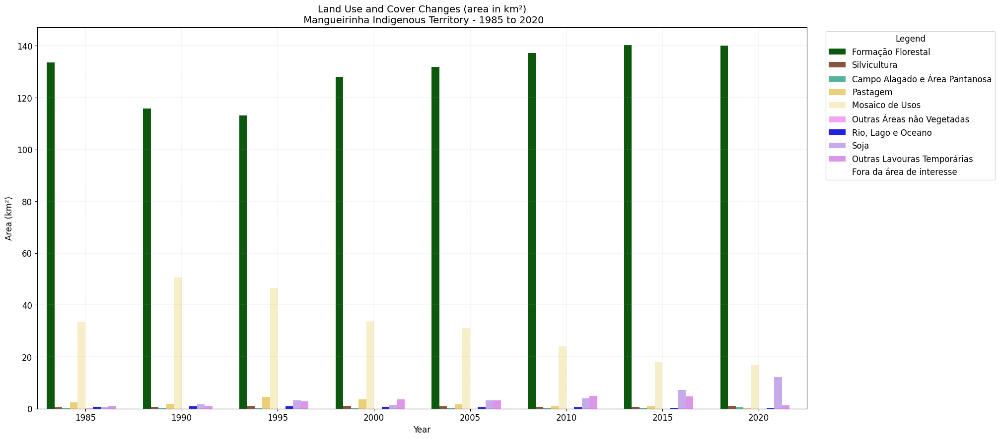

In [25]:
# Import required libraries for visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Create a figure and axes for the plot with specified size
fig, ax = plt.subplots(figsize=(20, 10))

# Generate a bar plot using Seaborn
# Data: 'df_melt' contains the melted DataFrame with columns for year, area, and class names
# x-axis: 'ano' (year), y-axis: 'Area_km_2' (area in km²), hue: 'nome_classe' (land use classes)
# Palette: 'paleta_nomes' defines the color scheme for different classes
sns.barplot(data=df_melt, x="ano", y="Area_km_2", hue="nome_classe", palette=paleta_nomes)

# Add a title to the plot
plt.title('Land Use and Cover Changes (area in km²)\n Mangueirinha Indigenous Territory - 1985 to 2020', fontsize=14)

# Customize x-axis
plt.xlabel('Year', fontsize=12)  # Label for the x-axis
plt.xticks(fontsize=12)  # Adjust font size for x-axis ticks

# Customize y-axis
plt.ylabel('Area (km²)', fontsize=12)  # Label for the y-axis
plt.yticks(fontsize=12)  # Adjust font size for y-axis ticks

# Add a grid to the background for better readability
plt.grid(linestyle='--', linewidth=0.2, which='both')  # Dashed grid lines with thin width

# Customize the legend
# Place the legend outside the plot to the upper-right corner, with a title and adjusted font size
ax.legend(loc="upper right", bbox_to_anchor=(1.25, 1), title="Legend", title_fontsize="12", fontsize='12')


In [26]:
# Select the class of interest
df_agro=df_melt[df_melt.nome_classe=='Soja']
df_agro

,ano,classe,nome_classe,Área_classe,Area_km_2
7,1985,39,Soja,area,0.47
16,1990,39,Soja,area,1.64
25,1995,39,Soja,area,3.25
34,2000,39,Soja,area,1.48
43,2005,39,Soja,area,3.11
52,2010,39,Soja,area,4.02
61,2015,39,Soja,area,7.29
69,2020,39,Soja,area,12.11


In [27]:
# Select the class of interest
df_veg=df_melt[df_melt.nome_classe=='Formação Florestal']
df_veg

,ano,classe,nome_classe,Área_classe,Area_km_2
0,1985,3,Formação Florestal,area,133.55
9,1990,3,Formação Florestal,area,115.77
19,1995,3,Formação Florestal,area,113.05
27,2000,3,Formação Florestal,area,128.11
36,2005,3,Formação Florestal,area,131.93
45,2010,3,Formação Florestal,area,137.15
54,2015,3,Formação Florestal,area,140.20
63,2020,3,Formação Florestal,area,140.04


In [28]:
# Select the class of interest
df_mosaico=df_melt[df_melt.nome_classe=='Mosaico de Usos']
df_mosaico

,ano,classe,nome_classe,Área_classe,Area_km_2
4,1985,21,Mosaico de Usos,area,33.47
13,1990,21,Mosaico de Usos,area,50.55
23,1995,21,Mosaico de Usos,area,46.53
31,2000,21,Mosaico de Usos,area,33.66
40,2005,21,Mosaico de Usos,area,31.11
49,2010,21,Mosaico de Usos,area,24.03
58,2015,21,Mosaico de Usos,area,17.84
67,2020,21,Mosaico de Usos,area,16.89


In [29]:
# Select the class of interest
df_silvicultura=df_melt[df_melt.nome_classe=='Silvicultura']
df_silvicultura

,ano,classe,nome_classe,Área_classe,Area_km_2
1,1985,9,Silvicultura,area,0.53
10,1990,9,Silvicultura,area,0.62
20,1995,9,Silvicultura,area,1.14
28,2000,9,Silvicultura,area,1.11
37,2005,9,Silvicultura,area,0.83
46,2010,9,Silvicultura,area,0.79
55,2015,9,Silvicultura,area,0.79
64,2020,9,Silvicultura,area,1.07


In [30]:
# Select the class of interest
df_Pastagem=df_melt[df_melt.nome_classe=='Pastagem']
df_Pastagem

,ano,classe,nome_classe,Área_classe,Area_km_2
3,1985,15,Pastagem,area,2.42
12,1990,15,Pastagem,area,1.77
22,1995,15,Pastagem,area,4.59
30,2000,15,Pastagem,area,3.62
39,2005,15,Pastagem,area,1.64
48,2010,15,Pastagem,area,0.85
57,2015,15,Pastagem,area,0.93
66,2020,15,Pastagem,area,0.42


In [31]:
# Select the class of interest
df_lavoura=df_melt[df_melt.nome_classe=='Outras Lavouras Temporárias']
df_lavoura

,ano,classe,nome_classe,Área_classe,Area_km_2
8,1985,41,Outras Lavouras Temporárias,area,1.07
17,1990,41,Outras Lavouras Temporárias,area,1.09
26,1995,41,Outras Lavouras Temporárias,area,2.87
35,2000,41,Outras Lavouras Temporárias,area,3.55
44,2005,41,Outras Lavouras Temporárias,area,3.13
53,2010,41,Outras Lavouras Temporárias,area,4.93
62,2015,41,Outras Lavouras Temporárias,area,4.73
70,2020,41,Outras Lavouras Temporárias,area,1.33


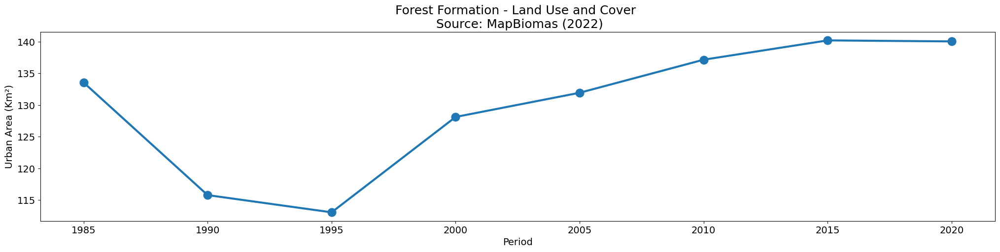

In [32]:
# Define the figure size
fig, ax = plt.subplots(figsize=(25, 5))  # Set the figure size to 25x5 inches

# Define the x and y data for the plot
x = df_veg['ano']  # 'ano' column represents the year
y = df_veg['Area_km_2']  # 'Area_km_2' column represents the forest area in km²

# Add a title to the plot
plt.title('Forest Formation - Land Use and Cover \n Source: MapBiomas (2022)', fontsize=18)

# Plot the data
# Use a line plot with circular markers, a line width of 3, and marker size of 12
plt.plot(x, y, marker='o', linewidth=3, markersize=12)

# Customize the x-axis
plt.xlabel('Period', fontsize=14)  # Label for the x-axis
plt.xticks(rotation=0, fontsize=14)  # Set the font size and ensure no rotation for x-axis ticks

# Customize the y-axis
plt.ylabel('Urban Area (Km²)', fontsize=14)  # Label for the y-axis
plt.yticks(fontsize=14)  # Set the font size for y-axis ticks

# Display the plot
plt.show()


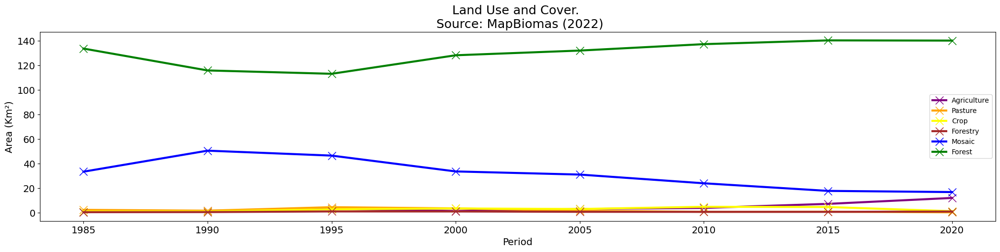

In [33]:

# Define the figure size
fig, ax = plt.subplots(figsize=(25, 5))  # Set the figure size to 25x5 inches

# Define the x-axis data (years)
x = df_veg['ano']  # 'ano' column represents the year

# Define the y-axis data for different land uses
y = df_agro['Area_km_2']  # Agriculture area in km²
y2 = df_Pastagem['Area_km_2']  # Pasture area in km²
y3 = df_lavoura['Area_km_2']  # Crop area in km²
y4 = df_silvicultura['Area_km_2']  # Forestry area in km²
y5 = df_mosaico['Area_km_2']  # Mosaic area in km²
y6 = df_veg['Area_km_2']  # Forest area in km²

# Add a title to the plot
plt.title('Land Use and Cover. \n Source: MapBiomas (2022)', fontsize=18)

# Plot the data for each land use category with unique styles and labels
plt.plot(x, y, marker='x', linewidth=3, markersize=12, color='purple', label='Agriculture')  # Agriculture data
plt.plot(x, y2, marker='x', linewidth=3, markersize=12, color='orange', label='Pasture')  # Pasture data
plt.plot(x, y3, marker='x', linewidth=3, markersize=12, color='yellow', label='Crop')  # Crop data
plt.plot(x, y4, marker='x', linewidth=3, markersize=12, color='brown', label='Forestry')  # Forestry data
plt.plot(x, y5, marker='x', linewidth=3, markersize=12, color='blue', label='Mosaic')  # Mosaic data
plt.plot(x, y6, marker='x', linewidth=3, markersize=12, color='green', label='Forest')  # Forest data

# Add a legend to the plot
plt.legend()  # Display the legend with labels for each line

# Customize the x-axis
plt.xlabel('Period', fontsize=14)  # Label for the x-axis
plt.xticks(rotation=0, fontsize=14)  # Set font size for x-axis ticks

# Customize the y-axis
plt.ylabel('Area (Km²)', fontsize=14)  # Label for the y-axis
plt.yticks(fontsize=14)  # Set font size for y-axis ticks

# Display the plot
plt.show()


In [34]:
# Now we want to do a sankey plot. To do so, we need to define the time interval for the plot transitions.
# Filter the image collection for every year you want to check the transitions.
map_1 = imageCollection.filter(ee.Filter.eq('year',1985))
map_2=imageCollection.filter(ee.Filter.eq('year',2001))
map_3= imageCollection.filter(ee.Filter.eq('year',2021))

# AddLayers
Map.addLayer(map_1, {'palette':palette_list, 'min':0, 'max':62},'1985')
Map.addLayer(map_2, {'palette':palette_list, 'min':0, 'max':62},'2001')
Map.addLayer(map_3, {'palette':palette_list, 'min':0, 'max':62},'2021')

Map.centerObject(region,12)

Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [35]:
# Create a list with the images
img_list = [map_1.first().rename('label'),
            map_2.first().rename('label'),
            map_3.first().rename('label')]
img_list

In [36]:
# Plot the chart
plot = sankee.sankify(
    image_list=img_list,
    band = "label",
    labels=dicionario_classes,
    palette=dicionario_cores,
    region=region.geometry(),
    max_classes=62,
    title="Uso e Ocupação do Solo - Terra Indígena Mangueirinha",
)

plot

SankeyPlot()

# 2. Data Collection

Foram obtidas imagens de satélites baseadas na correspondência temporal com a coleção de dados ESA CCI Biomass e da localização da área de estudo. Para obter as variáveis preditoras, optou-se pela integração de dados de sensores ópticos e radar, considerando a complementaridade desses sensores para análises de estrutura, vigor e composição da vegetação (Molisse et al. 2022).


Nota-se a necessidade de garantir a consistência temporal entre essas imagens e as datas dos produtos do ESA CCI Biomass. Isso visa garantir que as condições ambientais durante a coleta das imagens de satélite sejam o mais semelhantes possível às condições observadas pelo produto ESA CCI Biomass (Hunka et al. 2023).


Isso é importante para garantir que as diferenças observadas entre as imagens de satélite e os pontos de controle sejam devidas às características da paisagem e não a mudanças temporais não controladas. Portanto, é fundamental que haja correspondência e temporal entre as imagens de satélite, a coleção ESA CCI Biomass e o IFN da área de estudo, para poder comparar e interpretar os resultados (Hunka et al. 2023).


## ESA CCI Global Forest Above Ground Biomass

Este conjunto de dados fornece estimativas de florestas acima do solobiomassapara os anos de 2010, 2017, 2018, 2019 e 2020. Estas estimativas são derivadas de uma combinação de dados de observação da Terra, dependendo do ano, obtidos da missão Copernicus Sentinel-1, do instrumento ASAR da Envisat e do satélite avançado de observação terrestre da JAXA. (ALOS-1 e ALOS-2), juntamente com informações adicionais de outras fontes de observação da Terra. O conjunto de dados foi gerado como parte do programa Iniciativa para Mudanças Climáticas (CCI) da Agência Espacial Europeia (ESA) peloBiomassaEquipe CCI.

O conjunto de dados inclui observações multitemporais na banda L para todos os biomas e para cada ano. O acima do solobiomassa(AGB) utilizam alometrias revisadas, que agora são baseadas em uma coleção mais extensa de dados LiDAR espaciais das missões GEDI e ICESat-2.

Fonte: Santoro, M.; Cartus, O. (2023): ESA Biomass Climate Change Initiative (Biomass_cci): Global datasets of forest above-ground biomass for the years 2010, 2017, 2018, 2019 and 2020, v4. NERC EDS Centre for Environmental Data Analysis, 21 April 2023. doi:10.5285/af60720c1e404a9e9d2c145d2b2ead4e. https://dx.doi.org/10.5285/af60720c1e404a9e9d2c145d2b2ead4e

In [37]:
# Acessar o dataset
esa_agb = ee.ImageCollection('projects/sat-io/open-datasets/ESA/ESA_CCI_AGB')

# Definir o ano de uso
esa_agb = esa_agb.filterDate('2020-01-01','2020-12-31').first().select(['AGB'])

# Paleta de cores
vis_palette = ["#C6ECAE","#A1D490","#7CB970","#57A751","#348E32", "#267A29","#176520","#0C4E15","#07320D","#031807"]

# Visualizando
Map.addLayer(esa_agb,{'palette':vis_palette,'min':1,'max':450},'Above Ground Biomass 2020')
Map.addLayer(esa_agb.clip(region),{'palette':vis_palette,'min':1,'max':450},'Above Ground Biomass 2020 (Cliped)')
Map.centerObject(region,11)
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [38]:
# Clip the dataset for the area of interest
esa_agb = esa_agb.clip(region)

# Calculate the mean AGB (t/ha) at the AOI using zonal statistics
mean_biomass = esa_agb.reduceRegion(**{
    'reducer': ee.Reducer.mean(),
    'geometry': region,
    'scale': 100,  # Proper scale for the dataset
    'maxPixels': 1e9
})

# Get mean AGB value for the AOI
mean_biomass_value = mean_biomass.get('AGB').getInfo()

# Print the mean value
print(f'Mean Biomass (t/ha) in study area: {mean_biomass_value}')

# Compare with the National Forest Inventory AGB value
biomass_inventory = 151

# Print comparison
difference = mean_biomass_value - biomass_inventory
print(f'Difference between GEE and inventory biomass (t/ha): {difference}')


Mean Biomass (t/ha) in study area: 145.30831323825177
Difference between GEE and inventory biomass (t/ha): -5.69168676174823


In [39]:
# Create random points for sampling
# randomPoints = ee.FeatureCollection.randomPoints(region,1000,42);

# Map.centerObject(randomPoints);
# Map.addLayer(randomPoints, {}, 'random points');
# randomPoints

In [40]:
# # Extraindo valores de AGB conforme pontos das áreas de interesse
# extract_agb = esa_agb.sampleRegions(**{
#     'collection': randomPoints,
#     'scale':100,
#     'geometries':True
#     })

# print(extract_agb.size().getInfo())
# print(extract_agb.first().getInfo())
# print(type(extract_agb))

In [41]:
# Create grid samples
grid_samples = esa_agb.sample(**{
  'region': region,
  'geometries': True,
  'scale': 350
  });

In [42]:
# Define a function to extract centroid coordinates for each feature
def feature(feature):
    # Get the geometry of the feature and transform it to EPSG:4326 (WGS 84)
    coordinates = feature.geometry().transform('EPSG:4326').coordinates()
    # Set the longitude ('lon') and latitude ('lat') as properties of the feature
    return feature.set('lon', coordinates.get(0), 'lat', coordinates.get(1))

# Apply the function to each feature in the collection
amostras = grid_samples.map(feature)  # 'grid_samples' is the feature collection being processed

# Print information about the first feature in the collection
print(amostras.first().getInfo())


{'type': 'Feature', 'geometry': {'geodesic': False, 'type': 'Point', 'coordinates': [-52.24407065955299, -25.747204879518733]}, 'id': '0', 'properties': {'AGB': 44, 'lat': -25.747204879518733, 'lon': -52.24407065955299}}


In [43]:
# Extract AGB values with grid samples
extract_agb = esa_agb.sampleRegions(**{
    'collection': grid_samples,
    'scale':100,
    'geometries':True
    })

print(extract_agb.size().getInfo())
print(extract_agb.first().getInfo())
print(type(extract_agb))

1541
{'type': 'Feature', 'geometry': {'geodesic': False, 'type': 'Point', 'coordinates': [-52.243846080731956, -25.747429458339766]}, 'id': '0_0', 'properties': {'AGB': 44}}
<class 'ee.featurecollection.FeatureCollection'>


In [44]:
# Create a list with the grid samples extracted
Lista_df = extract_agb.reduceColumns(ee.Reducer.toList(1), ['AGB']).values().get(0)

In [45]:
# Transform the list into a pandas dataframe
df_agb = pd.DataFrame(Lista_df.getInfo(), columns=['AGB'])

In [46]:
# Calculate basic descriptive statistics
df_agb['AGB'].describe()

count    1541.000000
mean      144.735237
std        63.692229
min         1.000000
25%       101.000000
50%       161.000000
75%       194.000000
max       261.000000
Name: AGB, dtype: float64

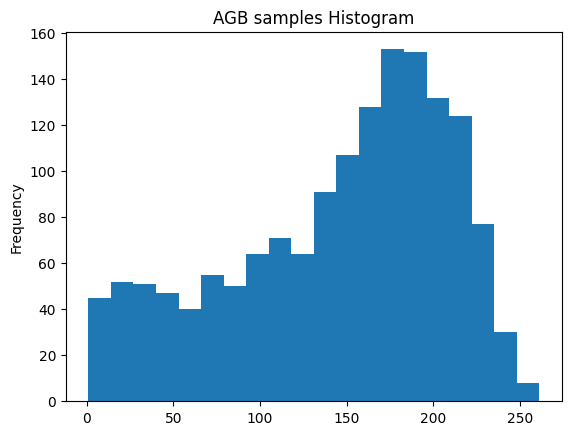

In [47]:
# Plot a histogram from AGB samples
df_agb['AGB'].plot(kind='hist', bins=20, title='AGB samples Histogram')
plt.gca().spines[['top', 'right',]].set_visible(True)

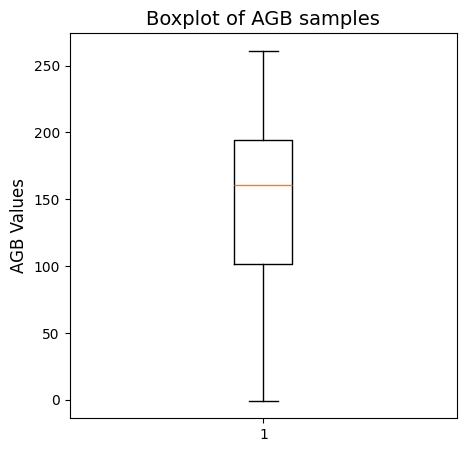

In [48]:
# Generate a random dataset based on the distribution of the AGB column in the dataframe
data = np.random.normal(loc=df_agb['AGB'])

# Create a new figure for the boxplot
fig = plt.figure(figsize=(5, 5))

# Create the boxplot
plt.boxplot(data)

# Add a title and labels for better presentation (optional)
plt.title("Boxplot of AGB samples", fontsize=14)
plt.ylabel("AGB Values", fontsize=12)

# Show the plot
plt.show()


In [49]:
# Calculate skewness and curtosis
data_skewness = skew(data)
data_kurtosis = kurtosis(data)

# Print the skewness and kurtosis
data_skewness, data_kurtosis

(-0.5998190463166206, -0.6550672537914939)

## ETH Global Sentinel-2 10m Canopy Height (2020)

O conjunto de dados ETH Global Sentinel-2 10m Canopy Height (2020) fornece uma estimativa global da altura do dossel florestal em metros, com uma resolução espacial de 10 metros, derivada de dados do Sentinel-2 em conjunto com dados do GEDI. Este dado é valioso para a predição de AGB, pois a altura do dossel está diretamente relacionada ao volume de biomassa presente em uma área florestal. Ao integrar essas estimativas em modelos preditivos, é possível melhorar a precisão do mapeamento de biomassa.

In [50]:

# ******** Load canopy top height (Lang et al., 2021) ********
# Define a color palette ("inferno") for canopy heights ranging from 0 m to 50 m
canopy_vis = {
    "min": 0.0,
    "max": 50.0,
    "palette": ['#010005', '#150b37', '#3b0964', '#61136e', '#85216b', '#a92e5e', '#cc4248', '#e75e2e', '#f78410', '#fcae12', '#f5db4c', '#fcffa4'],
}
# Define a color palette ("mako") for standard deviation ranging from 0 m to 15 m
sd_vis = {
    "min": 0.0,
    "max": 15.0,
    "palette": ['#0d0406', '#241628', '#36274d', '#403a76', '#3d5296', '#366da0', '#3488a6', '#36a2ab', '#44bcad', '#6dd3ad', '#aee3c0', '#def5e5'],
}
# Optional add UMD Canopy height map
#umd_canopy_height = ee.ImageCollection('users/potapovpeter/GEDI_V27')
#Map.addLayer(umd_canopy_height, canopy_vis, 'UMD Global Forest Canopy Height 2019')
standard_deviation = ee.Image('users/nlang/ETH_GlobalCanopyHeightSD_2020_10m_v1')
Map.addLayer(standard_deviation, sd_vis, 'Standard deviation')
canopy_height = ee.Image('users/nlang/ETH_GlobalCanopyHeight_2020_10m_v1')
Map.addLayer(canopy_height.clip(region), canopy_vis, 'Canopy top height')
Map.centerObject(region,11)
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [51]:
Map.addLayer(canopy_height.clip(region), canopy_vis, 'Canopy top height')


In [52]:
##Extraindo valores de AGB conforme pontos das áreas de interesse
extract_canopy = canopy_height.sampleRegions(**{
    'collection': extract_agb,
    'scale':100,
    'geometries':True
    })

print(extract_canopy.size().getInfo())
print(extract_canopy.first().getInfo())
print(type(extract_canopy))

1541
{'type': 'Feature', 'geometry': {'geodesic': False, 'type': 'Point', 'coordinates': [-52.24384608073194, -25.747627418524004]}, 'id': '0_0_0', 'properties': {'AGB': 44, 'b1': 17}}
<class 'ee.featurecollection.FeatureCollection'>


In [53]:
# extract_canopy = extract_canopy.select(['b1'], ['canopy_height'])

# # Visualiza o resultado
# print(extract_canopy.first().getInfo())

In [54]:
# Crie uma lista com os dados da malha amostral criada
Lista_df_canopy = extract_canopy.reduceColumns(ee.Reducer.toList(1), ['b1']).values().get(0)

In [55]:
# Visualize seu dataframe no utilizando os pandas
df_canopy = pd.DataFrame(Lista_df_canopy.getInfo(), columns=['b1'])
df_canopy.head(10)

,b1
0,17
1,19
2,14
3,15
4,21
5,12
6,12
7,16
8,22
9,18


In [56]:
# Análises estatísticas
df_canopy['b1'].describe()

count    1541.000000
mean       19.096690
std         5.312726
min         0.000000
25%        16.000000
50%        20.000000
75%        22.000000
max        32.000000
Name: b1, dtype: float64

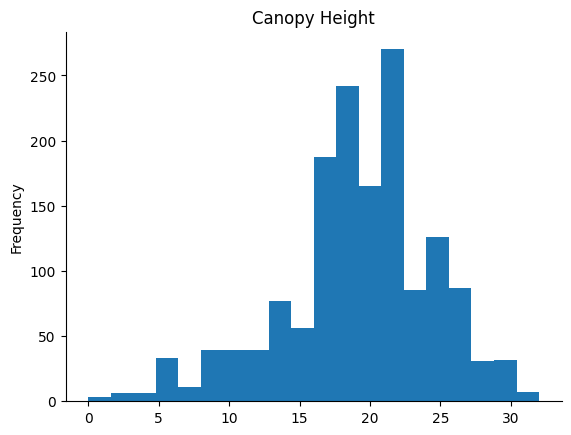

In [57]:
# Criando histograma para as amostras de AGB
df_canopy['b1'].plot(kind='hist', bins=20, title='Canopy Height')
plt.gca().spines[['top', 'right',]].set_visible(False)

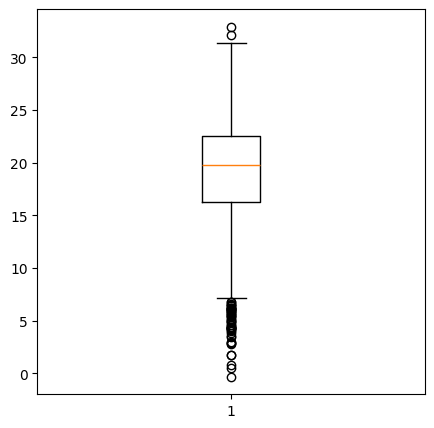

In [58]:
# Criando um box-plot
data_canopy = np.random.normal(df_canopy['b1'])
# Definindo o tamanho da figura
fig = plt.figure(figsize =(5, 5))
# Plotando os Resultados
plt.boxplot(data_canopy)
# Apresentando os resultados
plt.show()

## Harmonized Sentinel-2 MSI: MultiSpectral Instrument, Level-2A.

Sentinel-2 é uma missão de imageamento multiespectral de alta resolução e ampla cobertura, que apoia estudos de monitoramento terrestre do programa Copernicus. As imagens multiespectrais para este estudo serão obtidas através da coleção Harmonized Sentinel-2 MSI: MultiSpectral Instrument, Level-2A (ESA, 2023a).


As imagens contém 13 bandas multiespectrais com resolução espaciais variadas, cobrindo diferentes regiões do espectro eletromagnético. Dessas bandas, as que compõem a luz visível (azul = ‘B2’, verde= ‘B3’; vermelho = ‘B8’) e o infravermelho-próximo (NIR = ‘B4’) possuem 10 m de resolução espacial; Red-Edge (B5; B6; B7; B8A) e o infravermelho de ondas curtas (SWIR1 = ‘B11’; SWIR 2 = ‘B12’) possuem 20 m; enquantos as bandas ‘B1’, ‘B9’ e ‘QA60’ possuem 60 metros (ESA, 2023a).


In [59]:
# Mascara de nuvens para a banda pixel_qa SR Sentinel 2
def maskS2clouds(image):
  qa = image.select('QA60')
  # Bits 10 and 11 are clouds and cirrus, respectively.
  cloudBitMask = 1 << 10
  cirrusBitMask = 1 << 11
  # Both flags should be set to zero, indicating clear conditions.
  mask = qa.bitwiseAnd(cloudBitMask).eq(0).And(qa.bitwiseAnd(cirrusBitMask).eq(0))
  #Return the masked and scaled data, without the QA bands.
  return image.updateMask(mask).divide(10000)\
      .select("B.*")\
      .copyProperties(image, image.propertyNames())\
      .set('data', image.date().format('YYYY-MM-dd'))\
      .set({'millis': image.date().millis()})\
      .set({'ID': image.get('system:index')})

In [60]:
def calculate_indices(image):
    # Selecionar as bandas necessárias
    blue = image.select('B2')  # Banda Azul
    green = image.select('B3')  # Banda Verde
    red = image.select('B4')  # Banda Vermelha
    nir = image.select('B8')  # Banda NIR (Infravermelho Próximo)
    swir1 = image.select('B11')  # Banda SWIR1 (Infravermelho de Onda Curta 1)
    swir2 = image.select('B12')  # Banda SWIR2 (Infravermelho de Onda Curta 2)
    NIRnarrow = image.select('B8A') # Infravermelho próximo
    rededge1 = image.select('B5') # Borda do vermelho 1
    rededge2 = image.select('B6')
    rededge3 = image.select('B7')


    # Calculando os índices
    evi = image.expression(
        '2.5 * (NIR - RED) / (NIR + 6 * RED - 7.5 * BLUE + 1)', {
            'NIR': nir,
            'RED': red,
            'BLUE': blue
        }).rename('EVI') # Enhanced Vegetation Index

    savi = image.expression(
            "((NIRnarrow - RED) / (NIRnarrow + RED + 0.5) * 1.5)",
            {
              'NIRnarrow': NIRnarrow,
              'RED': red
    }).rename('SAVI') # Soil Adjusted Vegetation Index

    SRBlueRededge1 = image.expression(
                    "(BLUE / REDedge1)",
                    {
                      'BLUE': blue,
                      'REDedge1': rededge1
                }).rename('SRBlueRededge1') # SR-BlueRededge1 (Simple Blue and Red-edge 1 Ratio)


    SRNIRnarrowRededge1 = image.expression(
                          "(NIRnarrow / REDedge1)",
                          {
                            'NIRnarrow': NIRnarrow,
                            'REDedge1': rededge1
                  }).rename('SRNIRnarrowRededge1') # SR-NIRnarrowRededge1 (Simple NIR and Red-edge 1 Ratio)

    SRNIRnarrowRededge2 = image.expression(
                          "(NIRnarrow / REDedge2)",
                          {
                            'NIRnarrow': NIRnarrow,
                            'REDedge2': rededge2
                  }).rename('SRNIRnarrowRededge2') # SR-NIRnarrowRededge2 (Simple NIR and Red-edge 2 Ratio)


    PSSRa = image.expression(
              "(NIR / RED)",
              { 'NIR': nir,
                'RED': rededge1
      }).rename('PSSRa') # Pigment Specific Simple Ratio (chlorophyll index)


    GCI = image.expression(
              "((NIR/Green))-1",
              {
                'NIR': nir,
                'Green': green,
      }).rename('GCI') # Green Chlorophyll Index


    Lcaroc = image.expression(
        "(Rededge3) / (Blue - Rededge1)",
        { 'Rededge3': rededge3,
          'Blue': blue,
          'Rededge1': rededge1,
          }).rename('Lcaroc') # (Leaf Carotenoid Content)


    Lchloc = image.expression(
        "(Rededge3) / (Rededge1)",
        { 'Rededge3': rededge3,
          'Rededge1': rededge1,
          }).rename('Lchloc')


    LAI = image.expression('LAI = (0.3977 * exp(2.5556 * (NIR - RED) / (NIR + RED)))',
                          {
                              'NIR': nir,
                              'RED': red
                          }).rename('LAI') # Leaf Area Index (Leaf Area Index)

    PSRI = image.expression(
        "(Red-Green)/Rededge2",
        { 'Red': red,
          'Green': green,
         'Rededge2': rededge2,
          }).rename('PSRI') # (Plant Senescence Reflectance Index)

    nbr = image.normalizedDifference(['B8', 'B12']).rename('NBR')
    ndmi = image.normalizedDifference(['B8', 'B11']).rename('NDMI')
    ndwi = image.normalizedDifference(['B3', 'B8']).rename('NDWI')
    mndwi = image.normalizedDifference(['B3', 'B11']).rename('MNDWI')
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    gNDVI = image.normalizedDifference(['B8', 'B3']).rename('gNDVI') #(Green Normalized Difference Vegetation Index)
    NDVIre = image.normalizedDifference(['B8', 'B5']).rename('NDVIre') #(Normalized Difference Vegetation Index Red-edge)


    return image.addBands([evi,nbr,ndmi,ndwi,mndwi,ndvi,savi,gNDVI,NDVIre,SRBlueRededge1,
                           SRNIRnarrowRededge1,SRNIRnarrowRededge2,PSSRa,GCI,Lcaroc,Lchloc,PSRI,LAI])

In [61]:
##Agora vamos obter um ee.Image de um ee.ImageCollection
Sentinel2 = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED")\
         .filterBounds(ee.Geometry.Point([-52.34007901938789,-25.901559629835102]))\
         .filterDate('2020-01-01', '2020-12-31')\
         .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',5))\
         .map(maskS2clouds)\
         .select(['B.*'])\
         .map(calculate_indices)


print('Nº total de imagens :', Sentinel2.size().getInfo())

Nº total de imagens : 28


In [62]:
##Listar as imagens ID e datas
ID_date_list = Sentinel2.reduceColumns(ee.Reducer.toList(2), ['system:id','data']).values().get(0)
ID_date_list.getInfo()

[['COPERNICUS/S2_SR_HARMONIZED/20200118T133219_20200118T133218_T22JCS',
  '2020-01-18'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200222T133221_20200222T133219_T22JCS',
  '2020-02-22'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200227T133219_20200227T133221_T22JCS',
  '2020-02-27'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200303T133221_20200303T133220_T22JCS',
  '2020-03-03'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200308T133219_20200308T133222_T22JCS',
  '2020-03-08'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200313T133221_20200313T133220_T22JCS',
  '2020-03-13'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200323T133221_20200323T133221_T22JCS',
  '2020-03-23'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200412T133221_20200412T133223_T22JCS',
  '2020-04-12'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200422T133231_20200422T133226_T22JCS',
  '2020-04-22'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200422T133231_20200422T133935_T22JCS',
  '2020-04-22'],
 ['COPERNICUS/S2_SR_HARMONIZED/20200427T133219_20200427T133219_T22JCS',
  '2020-04-27'],
 ['COPERNICUS/S2_SR_H

In [63]:
# Nome das bandas disponíveis para nossa análise
Sentinel2.first().bandNames().getInfo()

['B1',
 'B2',
 'B3',
 'B4',
 'B5',
 'B6',
 'B7',
 'B8',
 'B8A',
 'B9',
 'B11',
 'B12',
 'EVI',
 'NBR',
 'NDMI',
 'NDWI',
 'MNDWI',
 'NDVI',
 'SAVI',
 'gNDVI',
 'NDVIre',
 'SRBlueRededge1',
 'SRNIRnarrowRededge1',
 'SRNIRnarrowRededge2',
 'PSSRa',
 'GCI',
 'Lcaroc',
 'Lchloc',
 'PSRI',
 'LAI']

In [64]:
# Reduzindo a coleção pela mediana
imageS2 = Sentinel2.median().clip(region)
rgb_vis = {
    'min': 0.0,
    'max': 0.1,
    'bands': ['B4', 'B3', 'B2'],
}

Map.addLayer(imageS2,rgb_vis,'Sentinel 2')
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [65]:
image_indice = Sentinel2.first().select('NBR').clip(region);
indiceParams = {'bands': ['NBR'], 'palette': ['#9e0142', '#a00343', '#a20643', '#a40844', '#a70b44', '#a90d45', '#ab0f45', '#ad1246',
                                              '#af1446', '#b11747', '#b41947', '#b61b48', '#b81e48', '#ba2049', '#bc2249', '#be254a',
                                              '#c1274a', '#c32a4b', '#c52c4b', '#c72e4c', '#c9314c', '#cb334d', '#cd364d', '#d0384e', '#d23a4e',
                                              '#d43d4f', '#d63f4f', '#d7414e', '#d8434e', '#d9444d', '#da464d', '#dc484c', '#dd4a4c', '#de4c4b',
                                              '#df4e4b', '#e1504b', '#e2514a', '#e3534a', '#e45549', '#e55749', '#e75948', '#e85b48', '#e95c47',
                                              '#ea5e47', '#eb6046', '#ed6246', '#ee6445', '#ef6645', '#f06744', '#f26944', '#f36b43', '#f46d43',
                                              '#f47044', '#f57245', '#f57547', '#f57748', '#f67a49', '#f67c4a', '#f67f4b', '#f7814c', '#f7844e',
                                              '#f8864f', '#f88950', '#f88c51', '#f98e52', '#f99153', '#f99355', '#fa9656', '#fa9857', '#fa9b58',
                                              '#fb9d59', '#fba05b', '#fba35c', '#fca55d', '#fca85e', '#fcaa5f', '#fdad60', '#fdaf62', '#fdb163',
                                              '#fdb365', '#fdb567', '#fdb768', '#fdb96a', '#fdbb6c', '#fdbd6d', '#fdbf6f', '#fdc171', '#fdc372',
                                              '#fdc574', '#fdc776', '#fec877', '#feca79', '#fecc7b', '#fece7c', '#fed07e', '#fed27f', '#fed481',
                                              '#fed683', '#fed884', '#feda86', '#fedc88', '#fede89', '#fee08b', '#fee18d', '#fee28f', '#fee491',
                                              '#fee593', '#fee695', '#fee797', '#fee999', '#feea9b', '#feeb9d', '#feec9f', '#feeda1', '#feefa3',
                                              '#fff0a6', '#fff1a8', '#fff2aa', '#fff3ac', '#fff5ae', '#fff6b0', '#fff7b2', '#fff8b4', '#fffab6',
                                              '#fffbb8', '#fffcba', '#fffdbc', '#fffebe', '#ffffbe', '#fefebd', '#fdfebb', '#fcfeba', '#fbfdb8',
                                              '#fafdb7', '#f9fcb5', '#f8fcb4', '#f7fcb2', '#f6fbb0', '#f5fbaf', '#f4faad', '#f3faac', '#f2faaa',
                                              '#f1f9a9', '#f0f9a7', '#eff9a6', '#eef8a4', '#edf8a3', '#ecf7a1', '#ebf7a0', '#eaf79e', '#e9f69d',
                                              '#e8f69b', '#e7f59a', '#e6f598', '#e4f498', '#e1f399', '#dff299', '#ddf19a', '#daf09a', '#d8ef9b',
                                              '#d6ee9b', '#d3ed9c', '#d1ed9c', '#cfec9d', '#cdeb9d', '#caea9e', '#c8e99e', '#c6e89f', '#c3e79f',
                                              '#c1e6a0', '#bfe5a0', '#bce4a0', '#bae3a1', '#b8e2a1', '#b5e1a2', '#b3e0a2', '#b1dfa3', '#aedea3',
                                              '#acdda4', '#aadca4', '#a7dba4', '#a4daa4', '#a2d9a4', '#9fd8a4', '#9cd7a4', '#99d6a4', '#97d5a4',
                                              '#94d4a4', '#91d3a4', '#8fd2a4', '#8cd1a4', '#89d0a4', '#86cfa5', '#84cea5', '#81cda5', '#7ecca5',
                                              '#7ccaa5', '#79c9a5', '#76c8a5', '#74c7a5', '#71c6a5', '#6ec5a5', '#6bc4a5', '#69c3a5', '#66c2a5',
                                              '#64c0a6', '#62bda7', '#60bba8', '#5eb9a9', '#5cb7aa', '#5ab4ab', '#58b2ac', '#56b0ad', '#54aead',
                                              '#52abae', '#50a9af', '#4ea7b0', '#4ba4b1', '#49a2b2', '#47a0b3', '#459eb4', '#439bb5', '#4199b6',
                                              '#3f97b7', '#3d95b8', '#3b92b9', '#3990ba', '#378ebb', '#358bbc', '#3389bd', '#3387bc', '#3585bb',
                                              '#3682ba', '#3880b9', '#3a7eb8', '#3b7cb7', '#3d79b6', '#3f77b5', '#4175b4', '#4273b3', '#4471b2',
                                              '#466eb1', '#486cb0', '#496aaf', '#4b68ae', '#4d65ad', '#4e63ac', '#5061aa', '#525fa9', '#545ca8',
                                              '#555aa7', '#5758a6', '#5956a5', '#5b53a4', '#5c51a3', '#5e4fa2'],
                                              'min': 0.1277023629964807, 'max': 0.69493545183714}
Map.addLayer(image_indice,indiceParams,'NBR')
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

## NASA SRTM Digital Elevation 30m (Shuttle Radar Topography Mission)

O Modelo Digital de Elevação (MDE) do SRTM (Shuttle Radar Topography Mission) é um projeto conjunto da NASA e da Agência Espacial Nacional da Alemanha (DLR) que mapeou a elevação terrestre para o ano de 2000. A topografia influencia a estrutura da vegetação e a biomassa, por isso é importante considerá-la no mapeamento. O MDE está disponível como uma imagem única global de resolução espacial de 30 m (Farr et al. 2007).

In [66]:
# .log(): Esta função aplica uma transformação logarítmica aos valores de elevação da imagem.
# Essa transformação é frequentemente usada para reduzir a variação nos dados de elevação,
# tornando os padrões mais fáceis de identificar, especialmente quando há grandes diferenças nos valores de elevação.

# .divide(10): A imagem resultante da transformação logarítmica é então dividida por 10.
# Esta é uma forma de normalização e pode ser específica para o contexto ou objetivo da análise.

# Adicionando dados de Elevação
srtm = ee.Image("USGS/SRTMGL1_003")
srtm = srtm.clip(region).log().divide(10).toFloat()

In [67]:
# Reprojete a image e adicione a banda do DEM...
image_s2_srtm = imageS2.addBands([srtm])
                    # .reproject('EPSG:4326', None, 100)

image_s2_srtm.bandNames().getInfo()

['B1',
 'B2',
 'B3',
 'B4',
 'B5',
 'B6',
 'B7',
 'B8',
 'B8A',
 'B9',
 'B11',
 'B12',
 'EVI',
 'NBR',
 'NDMI',
 'NDWI',
 'MNDWI',
 'NDVI',
 'SAVI',
 'gNDVI',
 'NDVIre',
 'SRBlueRededge1',
 'SRNIRnarrowRededge1',
 'SRNIRnarrowRededge2',
 'PSSRa',
 'GCI',
 'Lcaroc',
 'Lchloc',
 'PSRI',
 'LAI',
 'elevation']

In [68]:
Map.addLayer(image_s2_srtm.select('elevation'), {'min': 0.6, 'max': 0.7, 'palette': ['white', 'black']}, 'DEM');
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

## Sentinel-1 SAR GRD: C-band Synthetic Aperture Radar Ground Range Detected, log scaling

O Sentinel-1 é um radar de abertura sintética (SAR) que fornece dados sobre a estrutura da superfície da terra, e sofre menos interferência das condições climáticas ou da presença de luz solar, em comparação com sensores ópticos como o Sentinel-2. Ao contrário do Sentinel-2 que captura radiação solar refletida pela superfície, o Sentinel-1 emite pulsos de radar e registra a energia refletida pelos objetos na Terra, também chamada de retroespalhamento (backscattering) (ESA, 2023b).

As imagens de radar serão obtidas através da coleção Sentinel-1 SAR GRD: C-band Synthetic Aperture Radar Ground Range Detected, log scaling que oferece quatro bandas com diferentes polarizações (VV, HH, VH e HV), com resolução espacial de 10 m e unidade de medida em escala logarítmica (dB), permitindo a detecção de mudanças sutis na biomassa. Esse produto foi pré-processado através de calibração radiométrica, remoção de ruído termal, correção do terreno com SRTM 30 (Shuttle Radar Topography Mission) e ASTER DEM e ortorretificação. Contudo, este produto ainda precisa de pré-processamento adicional como filtro de ruído Speckle (ESA, 2023b).

In [69]:
# Referência: Erli Pinto dos Santos <https://github.com/eupassarinho/GoogleEarthEngine-sentinel1-vegetation-indices>

# SENTINEL-1 DATA PROCESSING: #
# The goal of this algorithm is process SAR images from Sentinel-1. The code does:

# 1) Creates a function to apply a speckle filter: in this case by Focal Median method

# 2) Creates a function that will, based on band histogram (from VV and VH FLOAT bands),
# remove a "heavy-tail" from their histograms: this part of distribution that is understood as
# outliers

# 3) Applying all functions above, the code creates a variable containing an image
# collection for each band. The result are the bands Sigma0_VV and Sigma0_VH

# 5) Creates and applies functions to compute all the SAR vegetation indices of interest:
# DPSVI original (Periasamy, 2018) and DPSVI modified


# Function to apply speckle noise removal filter by Focal Median:
# The window (the kernel) used to apply the filter is in pixel number, that is odd number
def MedianVV(image):
    return image.addBands(image.focal_median(**{'radius': 5,
                                                'kernelType': 'square',
                                                'units': 'pixels'})
                          .rename(['Sigma0_VV']))

def MedianVH(image):
    return image.addBands(image.focal_median(**{'radius': 5,
                                                'kernelType': 'square',
                                                'units': 'pixels'})
                          .rename(['Sigma0_VH']))

# Function to mask outliers in VV band based on histogram analysis
def maskVV(image):
    quantil90 = image.reduceRegion(**{'reducer':
                                      ee.Reducer.percentile(**{'percentiles': ee.List([95]),
                                                               'outputNames': ee.List(['p95'])}),
                                      'scale': 10,
                                      'bestEffort': True})
    Outliers = image.select('VV').lte(ee.Number(quantil90.get('VV')))
    return image.updateMask(Outliers)

def maskVH(image):
    quantil90 = image.reduceRegion(**{'reducer':
                                      ee.Reducer.percentile(**{'percentiles': ee.List([95]),
                                                               'outputNames': ee.List(['p95'])}),
                                      'scale': 10,
                                      'bestEffort': True})
    Outliers = image.select('VH').lte(ee.Number(quantil90.get('VH')))
    return image.updateMask(Outliers)


In [70]:
# Get AOI orbit number
sentinel1_orbitnumber = ee.ImageCollection('COPERNICUS/S1_GRD_FLOAT') \
              .filter(ee.Filter.eq('instrumentMode', 'IW')) \
              .filter(ee.Filter.eq('orbitProperties_pass', 'DESCENDING')) \
              .filterBounds(region) \
              .filterDate('2020-01-01', '2020-12-31') \
              .select('VV') \
              .map(maskVV) \
              .map(MedianVV)

# Obtenha uma lista de todos os números de órbita relativos.
orbit_numbers = sentinel1_orbitnumber.aggregate_array('relativeOrbitNumber_start').getInfo()
print('Lista de números de órbita relativa:', orbit_numbers)

# Filtre por uma imagem específica (por exemplo, a primeira imagem da coleção).
first_image = sentinel1_orbitnumber.first()

# Extraia e imprima o número de órbita relativo da primeira imagem.
orbit_number = first_image.get('relativeOrbitNumber_start').getInfo()
print('Número de órbita relativo da primeira imagem:', orbit_number)

Lista de números de órbita relativa: [97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97]
Número de órbita relativo da primeira imagem: 97


In [71]:
# Vars that will receive and pre-process the Sentinel-1 SAR choiced images:

sentinel1VV =   ee.ImageCollection('COPERNICUS/S1_GRD_FLOAT') \
                  .filter(ee.Filter.eq('instrumentMode', 'IW')) \
                  .filter(ee.Filter.eq('orbitProperties_pass', 'DESCENDING')) \
                  .filter(ee.Filter.eq('relativeOrbitNumber_start', 97)).filter(ee.Filter.eq('resolution_meters', 10)) \
                  .filterBounds(region).filter(ee.Filter.eq('resolution_meters', 10)) \
                  .filterBounds(region).filterDate('2020-01-01', '2020-12-31') \
                  .select('VV') \
                  .map(maskVV) \
                  .map(MedianVV) \
                  .select('Sigma0_VV')

# VH band
sentinel1VH =   ee.ImageCollection('COPERNICUS/S1_GRD_FLOAT').filter(ee.Filter.eq('instrumentMode', 'IW')) \
                .filter(ee.Filter.eq('orbitProperties_pass', 'DESCENDING')) \
                .filter(ee.Filter.eq('relativeOrbitNumber_start', 97)).filter(ee.Filter.eq('resolution_meters', 10)) \
                .filterBounds(region).filterDate('2020-01-01', '2020-12-31')\
                .select('VH') \
                .map(maskVH) \
                .map(MedianVH) \
                .select('Sigma0_VH')

# Combining both image collections (Sigma0_VV and Sigma0_VH):
sentinel1 = sentinel1VV.combine(sentinel1VH)
#print(sentinel1, "Sentinel-1 filtered images")

# Computing vegetation index over each image in collection:
# The outputs of this function are:
# The original Dual Polarization SAR Vegetation Index (DPSVI; Periasamy, 2018)
# and the modified DPSVI (proposed here):
def indices(image):
    max = image.reduceRegion(**{
        'reducer': ee.Reducer.max(),
        'scale': 10,
        'geometry': region,
        'bestEffort': True
    })
    DPSVIoriginal = image.expression(
        '(((VVmax - VV)+VH)/1.414213562) * ((VV+VH)/VV) * VH', {
            'VH': image.select('Sigma0_VH'),
            'VV': image.select('Sigma0_VV'),
            'VVmax': ee.Number(max.get('Sigma0_VV'))
        }
    )
    DPSVIm = image.expression(
        '(VV*VV+VV*VH)/1.414213562', {
            'VH': image.select('Sigma0_VH'),
            'VV': image.select('Sigma0_VV')
        }
    )

    SARVI = image.expression(
        '(VH/ VV + VH)', {
            'VH': image.select('Sigma0_VH'),
            'VV': image.select('Sigma0_VV')}
    )

    razaoVVVH = image.expression(
        '(VV/VH)', {
            'VH': image.select('Sigma0_VH'),
            'VV': image.select('Sigma0_VV')}
    )

    NDSI = image.expression(
        '(VV-VH/VV+VH)',{
        'VH': image.select('Sigma0_VH'),
        'VV': image.select('Sigma0_VV')}
    )

    return image.addBands([
        DPSVIm.rename("DPSVIm"),
        DPSVIoriginal.rename("DPSVIo"),
        SARVI.rename("SARVI"), # SAR Vegetation Index
        razaoVVVH.rename("razaoVVVH"), # Razão VV / VH
        NDSI.rename("NDSI") # Normalized Difference Backscattering
    ])


In [72]:
S1_indices = sentinel1.map(indices)
S1_indices

In [73]:
S1_indices.first().bandNames().getInfo()

['Sigma0_VV', 'Sigma0_VH', 'DPSVIm', 'DPSVIo', 'SARVI', 'razaoVVVH', 'NDSI']

In [74]:
imageS1 = S1_indices.median().clip(region)
imageS1

In [75]:
Map.addLayer(imageS1.select('DPSVIm'),{'palette': ['#9e0142', '#a00343', '#a20643', '#a40844', '#a70b44', '#a90d45', '#ab0f45', '#ad1246', '#af1446', '#b11747', '#b41947', '#b61b48', '#b81e48', '#ba2049', '#bc2249', '#be254a', '#c1274a', '#c32a4b', '#c52c4b', '#c72e4c', '#c9314c', '#cb334d', '#cd364d', '#d0384e', '#d23a4e', '#d43d4f', '#d63f4f', '#d7414e', '#d8434e', '#d9444d', '#da464d', '#dc484c', '#dd4a4c', '#de4c4b', '#df4e4b', '#e1504b', '#e2514a', '#e3534a', '#e45549', '#e55749', '#e75948', '#e85b48', '#e95c47', '#ea5e47', '#eb6046', '#ed6246', '#ee6445', '#ef6645', '#f06744', '#f26944', '#f36b43', '#f46d43', '#f47044', '#f57245', '#f57547', '#f57748', '#f67a49', '#f67c4a', '#f67f4b', '#f7814c', '#f7844e', '#f8864f', '#f88950', '#f88c51', '#f98e52', '#f99153', '#f99355', '#fa9656', '#fa9857', '#fa9b58', '#fb9d59', '#fba05b', '#fba35c', '#fca55d', '#fca85e', '#fcaa5f', '#fdad60', '#fdaf62', '#fdb163', '#fdb365', '#fdb567', '#fdb768', '#fdb96a', '#fdbb6c', '#fdbd6d', '#fdbf6f', '#fdc171', '#fdc372', '#fdc574', '#fdc776', '#fec877', '#feca79', '#fecc7b', '#fece7c', '#fed07e', '#fed27f', '#fed481', '#fed683', '#fed884', '#feda86', '#fedc88', '#fede89', '#fee08b', '#fee18d', '#fee28f', '#fee491', '#fee593', '#fee695', '#fee797', '#fee999', '#feea9b', '#feeb9d', '#feec9f', '#feeda1', '#feefa3', '#fff0a6', '#fff1a8', '#fff2aa', '#fff3ac', '#fff5ae', '#fff6b0', '#fff7b2', '#fff8b4', '#fffab6', '#fffbb8', '#fffcba', '#fffdbc', '#fffebe', '#ffffbe', '#fefebd', '#fdfebb', '#fcfeba', '#fbfdb8', '#fafdb7', '#f9fcb5', '#f8fcb4', '#f7fcb2', '#f6fbb0', '#f5fbaf', '#f4faad', '#f3faac', '#f2faaa', '#f1f9a9', '#f0f9a7', '#eff9a6', '#eef8a4', '#edf8a3', '#ecf7a1', '#ebf7a0', '#eaf79e', '#e9f69d', '#e8f69b', '#e7f59a', '#e6f598', '#e4f498', '#e1f399', '#dff299', '#ddf19a', '#daf09a', '#d8ef9b', '#d6ee9b', '#d3ed9c', '#d1ed9c', '#cfec9d', '#cdeb9d', '#caea9e', '#c8e99e', '#c6e89f', '#c3e79f', '#c1e6a0', '#bfe5a0', '#bce4a0', '#bae3a1', '#b8e2a1', '#b5e1a2', '#b3e0a2', '#b1dfa3', '#aedea3', '#acdda4', '#aadca4', '#a7dba4', '#a4daa4', '#a2d9a4', '#9fd8a4', '#9cd7a4', '#99d6a4', '#97d5a4', '#94d4a4', '#91d3a4', '#8fd2a4', '#8cd1a4', '#89d0a4', '#86cfa5', '#84cea5', '#81cda5', '#7ecca5', '#7ccaa5', '#79c9a5', '#76c8a5', '#74c7a5', '#71c6a5', '#6ec5a5', '#6bc4a5', '#69c3a5', '#66c2a5', '#64c0a6', '#62bda7', '#60bba8', '#5eb9a9', '#5cb7aa', '#5ab4ab', '#58b2ac', '#56b0ad', '#54aead', '#52abae', '#50a9af', '#4ea7b0', '#4ba4b1', '#49a2b2', '#47a0b3', '#459eb4', '#439bb5', '#4199b6', '#3f97b7', '#3d95b8', '#3b92b9', '#3990ba', '#378ebb', '#358bbc', '#3389bd', '#3387bc', '#3585bb', '#3682ba', '#3880b9', '#3a7eb8', '#3b7cb7', '#3d79b6', '#3f77b5', '#4175b4', '#4273b3', '#4471b2', '#466eb1', '#486cb0', '#496aaf', '#4b68ae', '#4d65ad', '#4e63ac', '#5061aa', '#525fa9', '#545ca8', '#555aa7', '#5758a6', '#5956a5', '#5b53a4', '#5c51a3', '#5e4fa2'], 'min': 0.005224939376608155, 'max': 0.010343865472473745},'DPSVIm')
Map

Map(center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['position', 'transpare…

In [76]:
imageS1_reprojetada = imageS1.reproject('EPSG:4326', None, 100)

imageS1_reprojetada.bandNames().getInfo()

['Sigma0_VV', 'Sigma0_VH', 'DPSVIm', 'DPSVIo', 'SARVI', 'razaoVVVH', 'NDSI']

In [77]:
# Extraindo valores das bandas do sentinel 1 conforme pontos das áreas de interesse
extract_sentinel1 = imageS1_reprojetada.sampleRegions(**{
    'collection': extract_canopy,
    'scale':100,
    'geometries':True
    })

print(extract_sentinel1.size().getInfo())
print(extract_sentinel1.first().getInfo())
print(type(extract_sentinel1))

1539
{'type': 'Feature', 'geometry': {'geodesic': False, 'type': 'Point', 'coordinates': [-52.243771136181074, -25.747961831075784]}, 'id': '0_0_0_0', 'properties': {'AGB': 44, 'DPSVIm': 0.0011777169767238165, 'DPSVIo': 0.0003464807900344721, 'NDSI': -0.12189481407403946, 'SARVI': 0.1783655732870102, 'Sigma0_VH': 0.005486000794917345, 'Sigma0_VV': 0.03753155469894409, 'b1': 17, 'razaoVVVH': 5.950864315032959}}
<class 'ee.featurecollection.FeatureCollection'>


In [78]:
extract_sentinel1

In [79]:
# imageS2_S1 = image_s2_srtm.addBands(canopy_height)
# imageS2_S1

In [80]:
imageS2_S1 = image_s2_srtm.addBands(imageS1_reprojetada)
imageS2_S1

In [92]:
image_s2_s1_b1 = imageS2_S1.addBands(canopy_height)
image_s2_s1_b1

In [82]:
# # Resample the image
# image_s2_s1_b1 = image_s2_s1_b1.resample('bilinear')

# 3. Data Export

In [83]:
# Criando geometria para função de exportação da imagem
geometry = ee.Geometry.Polygon(
        [[[-52.4459524870798, -25.697343358672263],
          [-52.4459524870798, -26.029755652737688],
          [-52.1328421355173, -26.029755652737688],
          [-52.1328421355173, -25.697343358672263]]]);

In [84]:
# # Exportar image
# task = ee.batch.Export.image.toDrive(
#     image=image_s2_s1_b1.toFloat(),
#     description='Sentinel_2_1_b1',
#     folder='TCC_MBA',
#     maxPixels= 1e13,
#     region=geometry,
#     scale=10,
#     crs='EPSG:4326'
# )
# task.start()

In [85]:
# task.status()

In [93]:
# Amostragem das variáveis preditoras
samples = image_s2_s1_b1.sampleRegions(
  collection= extract_sentinel1,
  scale= 100,
  geometries=True
  # 'properties': ['AGB']
);

samples

In [94]:
# Labels das bandas utilizadas
labels =['AGB','b1', 'EVI', 'MNDWI', 'NBR', 'NDMI', 'NDVI','NDWI','SAVI','elevation','gNDVI',
        'NDVIre',
        'SRBlueRededge1',
        'SRNIRnarrowRededge1',
        'SRNIRnarrowRededge2',
        'PSSRa',
        'GCI',
        'Lcaroc',
        'Lchloc',
        'PSRI',
        'LAI',
        'Sigma0_VV',
        'Sigma0_VH',
        'DPSVIm',
        'DPSVIo',
        'SARVI',
        'razaoVVVH',
        'NDSI'
        ]

# Crie uma lista com os dados da malha amostra que você criou
Lista_df = samples.reduceColumns(ee.Reducer.toList(28), labels).values().get(0)

# Visualize seu dataframe no utilizando os pandas
df_samples = pd.DataFrame(Lista_df.getInfo(), columns=labels)
df_samples

,AGB,b1,EVI,MNDWI,NBR,NDMI,NDVI,NDWI,SAVI,elevation,...,Lchloc,PSRI,LAI,Sigma0_VV,Sigma0_VH,DPSVIm,DPSVIo,SARVI,razaoVVVH,NDSI
0,44,17,0.530732,-0.509823,0.589093,0.308231,0.793811,-0.720383,0.505322,0.627476,...,3.407469,-0.062680,3.024085,0.037532,0.005486,0.001178,0.000346,0.178366,5.950864,-0.121895
1,46,19,0.406129,-0.528091,0.546230,0.269620,0.777605,-0.708709,0.412831,0.627099,...,3.356339,-0.057027,2.901392,0.049290,0.008607,0.002057,0.000449,0.182493,5.790218,-0.108482
2,68,14,0.593801,-0.559875,0.646756,0.349455,0.859654,-0.763449,0.563049,0.624611,...,4.003582,-0.077258,3.578291,0.066137,0.014268,0.003741,0.000666,0.235785,4.565714,-0.131452
3,196,15,0.624118,-0.524993,0.627910,0.341527,0.844501,-0.736810,0.569672,0.642325,...,3.612996,-0.083590,3.442335,0.072551,0.016569,0.004552,0.000716,0.245982,4.316397,-0.140019
4,120,21,0.514881,-0.575620,0.670875,0.374341,0.877951,-0.785370,0.504159,0.639024,...,4.326251,-0.072239,3.749633,0.080096,0.018017,0.005644,0.000751,0.252102,4.324578,-0.138408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1534,60,9,0.371551,-0.547598,0.370159,0.118769,0.638177,-0.621339,0.386666,0.680794,...,2.310502,-0.016835,2.031707,0.082558,0.019058,0.005967,0.000812,0.250846,4.320187,-0.126249
1535,108,17,0.611220,-0.579545,0.688682,0.385798,0.879781,-0.781162,0.581811,0.687005,...,4.433024,-0.074587,3.767391,0.086445,0.019901,0.006466,0.000749,0.251344,4.325184,-0.118740
1536,71,16,0.523523,-0.596630,0.586775,0.289613,0.830476,-0.752416,0.505856,0.693537,...,4.021627,-0.061424,3.321137,0.086142,0.019835,0.006450,0.000754,0.252111,4.321175,-0.125739
1537,48,18,0.549671,-0.587502,0.597535,0.304213,0.828847,-0.754422,0.526237,0.694022,...,4.001289,-0.058342,3.307394,0.084130,0.019162,0.006113,0.000741,0.251220,4.273146,-0.127898


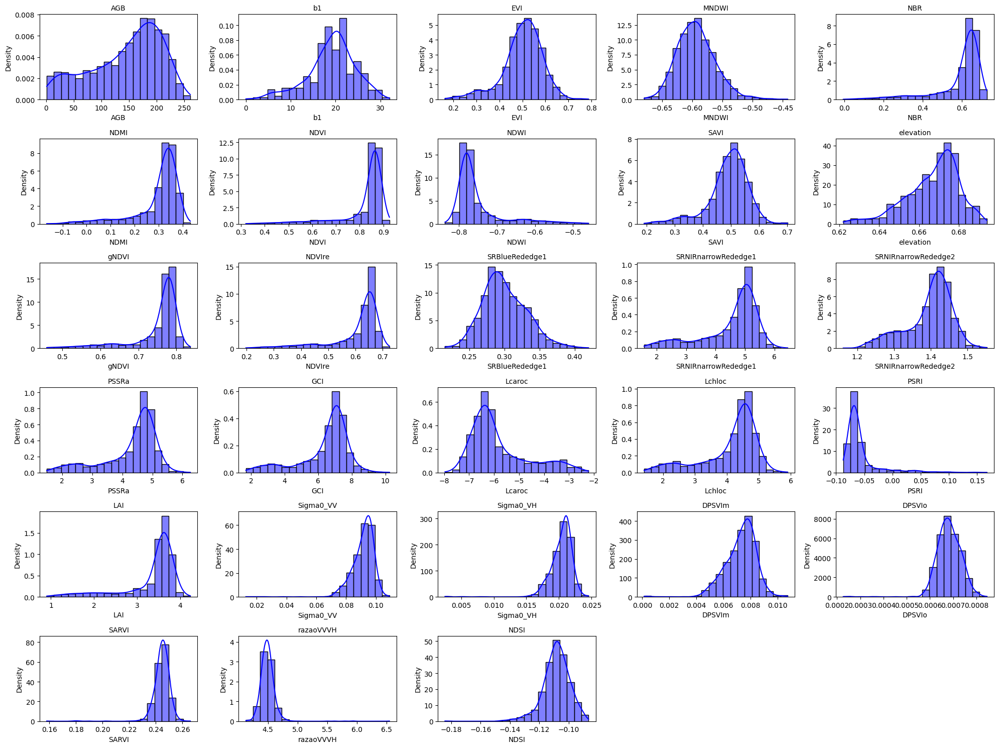

In [95]:
# Definindo o tamanho da figura
plt.figure(figsize=(20, 15))

# Escolhendo o tipo de gráfico (histogramas ou boxplots)
# Aqui, optamos por usar histogramas, mas você pode alterar para boxplots se preferir
for i, label in enumerate(df_samples.columns):
    plt.subplot(6, 5, i + 1)  # Organizando os gráficos em 6 linhas e 5 colunas
    sns.histplot(df_samples[label], kde=True, bins=20, color='blue', stat='density', linewidth=1)
    plt.title(label, fontsize=10)
    plt.tight_layout()

# Mostrando o gráfico
plt.show()


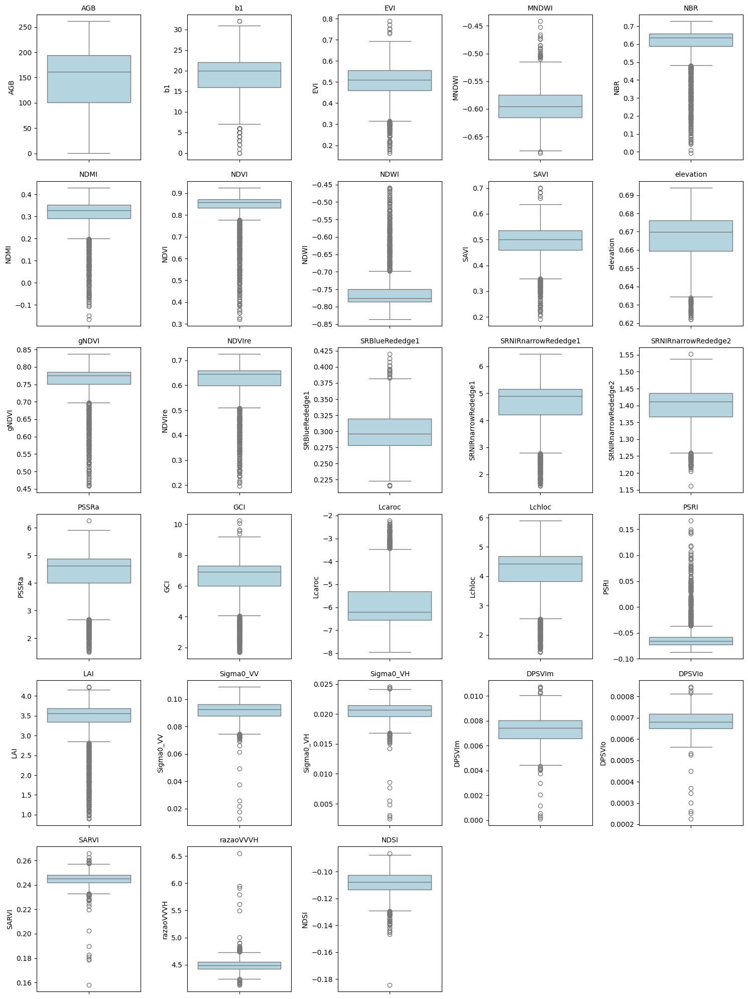

In [96]:
# Definindo o tamanho da figura
plt.figure(figsize=(15, 20))

# Gerando boxplots para cada variável
for i, label in enumerate(df_samples.columns):
    plt.subplot(6, 5, i + 1)  # Organizando os gráficos em 6 linhas e 5 colunas
    sns.boxplot(data=df_samples[label], color='lightblue')
    plt.title(label, fontsize=10)
    plt.tight_layout()

# Mostrando o gráfico
plt.show()


In [90]:
# # Exportar dados csv das amostras
# df_samples.to_csv('/content/drive/MyDrive/TCC_MBA/df_samples.csv')

In [97]:
# import pingouin as pg

# # Correlation analysis
# correlation_matrix2 = pg.rcorr(df_samples, method='pearson',
#                               upper='pval', decimals=4,
#                               pval_stars={0.01: '***',
#                                           0.05: '**',
#                                           0.10: '*'})
# correlation_matrix2

,AGB,b1,EVI,MNDWI,NBR,NDMI,NDVI,NDWI,SAVI,elevation,...,Lchloc,PSRI,LAI,Sigma0_VV,Sigma0_VH,DPSVIm,DPSVIo,SARVI,razaoVVVH,NDSI
AGB,-,***,***,***,***,***,***,***,***,***,...,***,***,***,***,***,***,***,***,***,***
b1,0.6416,-,***,***,***,***,***,***,***,**,...,***,***,***,***,***,***,***,***,***,***
EVI,0.4318,0.2887,-,***,***,***,***,***,***,***,...,***,***,***,***,***,***,***,***,,***
MNDWI,-0.365,-0.4575,-0.4608,-,***,***,***,***,***,,...,***,***,***,***,***,***,***,***,***,***
NBR,0.6416,0.6638,0.7907,-0.4822,-,***,***,***,***,***,...,***,***,***,***,***,***,***,***,***,***
NDMI,0.6294,0.661,0.7893,-0.4435,0.9927,-,***,***,***,***,...,***,***,***,***,***,***,***,***,***,***
NDVI,0.6056,0.6417,0.822,-0.6031,0.9769,0.9609,-,***,***,***,...,***,***,***,***,***,***,***,***,***,***
NDWI,-0.6082,-0.6688,-0.796,0.6848,-0.9562,-0.9464,-0.9817,-,***,***,...,***,***,***,***,***,***,***,***,***,***
SAVI,0.4518,0.3271,0.9948,-0.4897,0.8246,0.8204,0.8563,-0.831,-,***,...,***,***,***,***,***,***,***,***,,***
elevation,-0.2477,-0.0541,-0.2018,-0.0314,-0.1675,-0.1628,-0.1579,0.1228,-0.2051,-,...,***,***,***,***,***,,***,***,***,


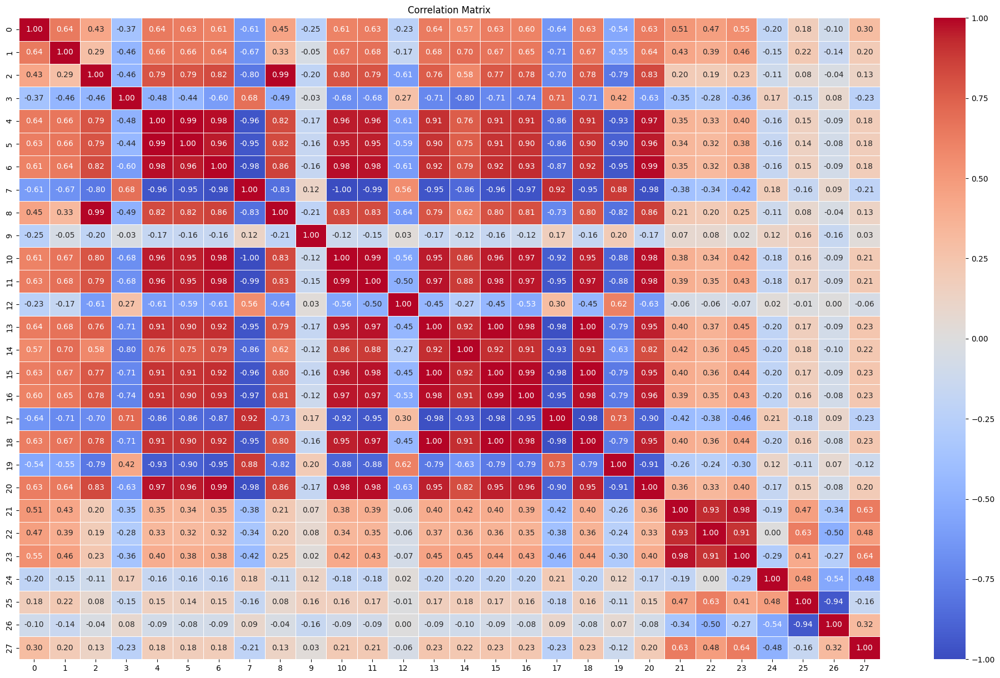

In [102]:
# # Matriz de correlação
# correlation_matrix = df_samples.corr(method='pearson')

# # Heatmap
# plt.figure(figsize=(25, 15))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
# plt.title("Correlation Matrix")
# plt.show()

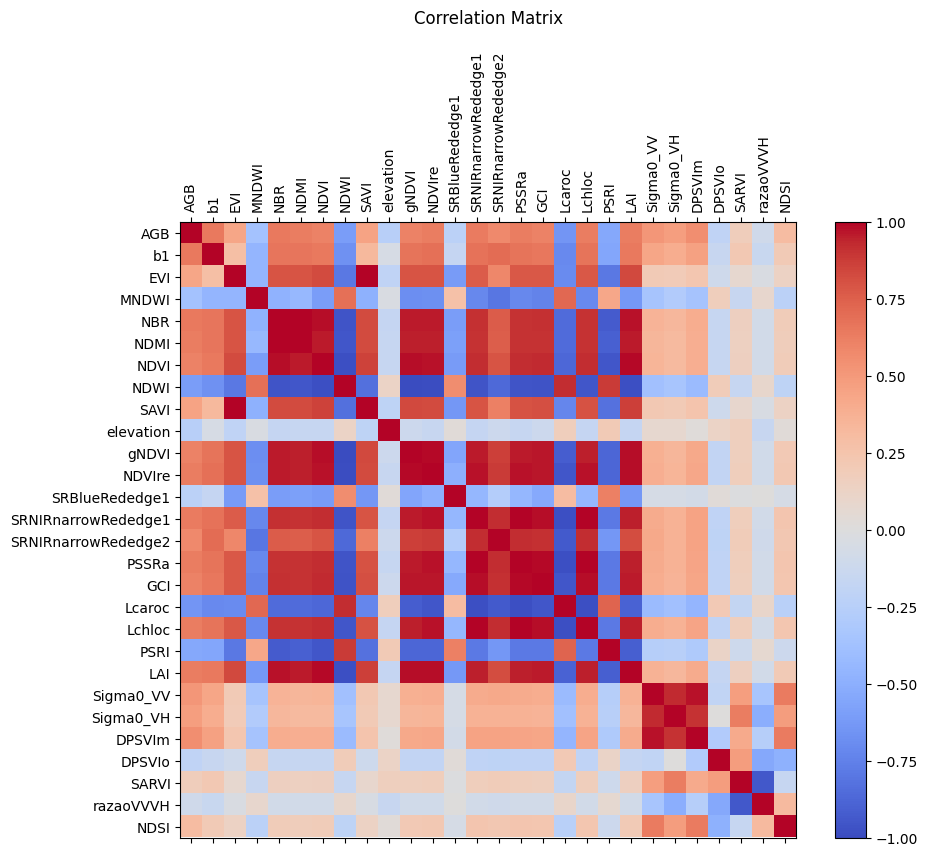

In [103]:
import numpy as np
import matplotlib.pyplot as plt

# Matriz de correlação
correlation_matrix = df_samples.corr(method='pearson')

# Plot customizado
fig, ax = plt.subplots(figsize=(10, 8))
cax = ax.matshow(correlation_matrix, cmap='coolwarm')
fig.colorbar(cax)

# Adicionar rótulos
ticks = np.arange(0, len(correlation_matrix.columns), 1)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(correlation_matrix.columns, rotation=90)
ax.set_yticklabels(correlation_matrix.columns)

plt.title("Correlation Matrix", pad=20)
plt.show()


# 4. K-fold Cross-Validation and Standardization with RobustScaler

Neste estudo foi implementada a validação cruzada k-fold, uma técnica utilizada para avaliar a performance de modelos preditivos, dividindo o conjunto de dados em k subconjuntos ou folds. O modelo é treinado em k-1 partes e testado na parte restante, repetindo esse processo k vezes, de modo que cada subconjunto seja utilizado tanto para treino quanto para teste.


In [98]:
# get the dataset
dataset = gpd.read_file('/content/drive/MyDrive/MBA - Data Science & Analytics/TCC_MBA')
dataset.head(10)

,field_1,AGB,b1,EVI,MNDWI,NBR,NDMI,NDVI,NDWI,SAVI,...,Lchloc,PSRI,LAI,Sigma0_VV,Sigma0_VH,DPSVIm,DPSVIo,SARVI,razaoVVVH,NDSI
0,0,44,17,0.38393705388256477,2.5087291844646895,0.047669519856028394,0.1545086871573794,-0.20069193539524005,0.3794890033537211,0.261482542637361,...,-0.7106139059508156,-0.22880560255004376,-0.4059919637296339,0.03753155469894409,0.005486000794917345,0.0011777169767238165,0.0003464807900344721,0.1783655732870102,5.950864315032959,-0.12189481407403946
1,1,46,19,-0.991072422719017,1.9512584514898315,-0.27240421350145616,-0.22035636145645318,-0.35036147539368506,0.547742468919504,-0.9808120534780755,...,-0.7659320464689254,-0.07377784220376389,-0.5868671457255731,0.04929022490978241,0.008606597781181335,0.0020567453607950275,0.00044924227571798846,0.1824933886528015,5.790218353271484,-0.10848236083984375
2,2,68,14,1.0799142126354293,0.9813337698130372,0.4782500388931355,0.5547491848246172,0.40741216821994647,-0.24124365507065065,1.0368517447514203,...,-0.06567230509795291,-0.628579580787887,0.4110207386814859,0.0661369264125824,0.014267612248659134,0.003741157069122378,0.0006658136224387437,0.23578515648841858,4.565713882446289,-0.1314515620470047
3,3,196,15,1.4144643834532626,2.045818482144395,0.3375226178086512,0.47777331465477985,0.2674652829105912,0.14270854371680752,1.1258135180616655,...,-0.48825151550557544,-0.8022476722898432,0.21059382691512857,0.07255075126886368,0.016568562015891075,0.0045515626631746214,0.0007159267635184195,0.24598155915737152,4.316396713256836,-0.14001917839050293
4,4,120,21,0.209022922934222,0.500837779317462,0.6583494302262843,0.7963655655992619,0.5763982042573541,-0.557208381535573,0.24587363439757254,...,0.28342616233341633,-0.4909561648481775,0.6636127996552177,0.08009636402130127,0.01801745593547821,0.005643632571787065,0.0007513277569774865,0.25210249423980713,4.324577808380127,-0.1384083479642868
5,5,42,12,-1.4020900764179496,2.784042258885322,-1.2998370520688871,-1.2108531717756044,-1.3320429792056618,1.6675645319035255,-1.4309358617481538,...,-1.7145323333746412,0.27053743716448025,-1.6033980938621626,0.061258696019649506,0.0077108582481741905,0.0029811042543995536,0.00036955483375090883,0.1896490454673767,5.496120452880859,-0.0917733833193779
6,6,51,12,-0.8480234193626301,3.854242917440389,-0.7833018160253101,-0.7911017115532613,-1.182881536267461,1.7615641690412773,-1.0343779173076313,...,-1.7348892955883863,0.05228647200282099,-1.466911796009867,0.07828451693058014,0.017137018963694572,0.005287915222813093,0.0007382031877721539,0.24779796600341797,4.3609418869018555,-0.13121451437473297
7,7,181,16,0.8922728513526617,1.1132197932939287,0.27972290977787667,0.3371726270092318,0.26161913905382905,0.022127151127982553,0.8033345838755213,...,-0.468837351564632,-0.691199095265982,0.20292863533701958,0.08058151602745056,0.017873957753181458,0.005605164733901872,0.0007487834039978292,0.24426960945129395,4.43491792678833,-0.13271497189998627
8,8,192,22,0.6416286766684408,0.4234155832913111,0.7272107658468175,0.8451694472443071,0.5912425653912003,-0.5284925941999302,0.6643425739133816,...,0.6218744915739683,-0.5813771058524503,0.6862867156504655,0.08080234378576279,0.018855731934309006,0.005707059960467383,0.0008095305441337536,0.24522781372070312,4.4337239265441895,-0.1287538856267929
9,9,133,18,0.899484962970586,0.4940004708512972,0.8289725767192305,0.9750425921167905,0.6504581675260311,-0.6728799543899716,0.9504113415049307,...,0.6448906350173477,-0.5234238551186654,0.7780098082812628,0.08789023756980896,0.019367467612028122,0.006627719454053049,0.0006788566237286491,0.2401452660560608,4.598306655883789,-0.11466570198535919


In [100]:
# get only rows with AGB values
modeling_dataset = dataset
modeling_dataset = pd.DataFrame(modeling_dataset.loc[dataset['AGB']!=-9999.0])
modeling_dataset = dataset.drop('field_1', axis=1)

In [101]:
# Substitui strings vazias por NaN em todo o DataFrame
modeling_dataset = modeling_dataset.replace("", float("NaN"))

# Remove linhas que contêm NaN (agora incluindo as que tinham strings vazias)
modeling_dataset = modeling_dataset.dropna()

In [102]:
# separate modeling_dataset into features (X) and AGB (y)
X = modeling_dataset.drop('AGB',axis = 1)
y = pd.DataFrame(modeling_dataset['AGB'])

In [103]:
y.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1539 entries, 0 to 1538
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   AGB     1539 non-null   object
dtypes: object(1)
memory usage: 12.1+ KB


In [104]:
# Convert the 'AGB' column of 'y' to numeric before the cross-validation loop
y['AGB'] = pd.to_numeric(y['AGB'], errors='coerce')

In [105]:
y.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1539 entries, 0 to 1538
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   AGB     1539 non-null   int64
dtypes: int64(1)
memory usage: 12.1 KB


In [106]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1539 entries, 0 to 1538
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   b1                   1539 non-null   object
 1   EVI                  1539 non-null   object
 2   MNDWI                1539 non-null   object
 3   NBR                  1539 non-null   object
 4   NDMI                 1539 non-null   object
 5   NDVI                 1539 non-null   object
 6   NDWI                 1539 non-null   object
 7   SAVI                 1539 non-null   object
 8   elevation            1539 non-null   object
 9   gNDVI                1539 non-null   object
 10  NDVIre               1539 non-null   object
 11  SRBlueRededge1       1539 non-null   object
 12  SRNIRnarrowRededge1  1539 non-null   object
 13  SRNIRnarrowRededge2  1539 non-null   object
 14  PSSRa                1539 non-null   object
 15  GCI                  1539 non-null   object
 16  Lcaroc

In [107]:

# Convert all columns in X to float
for column in X.columns:
  X[column] = pd.to_numeric(X[column], errors='coerce')

X.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1539 entries, 0 to 1538
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   b1                   1539 non-null   int64  
 1   EVI                  1539 non-null   float64
 2   MNDWI                1539 non-null   float64
 3   NBR                  1539 non-null   float64
 4   NDMI                 1539 non-null   float64
 5   NDVI                 1539 non-null   float64
 6   NDWI                 1539 non-null   float64
 7   SAVI                 1539 non-null   float64
 8   elevation            1539 non-null   float64
 9   gNDVI                1539 non-null   float64
 10  NDVIre               1539 non-null   float64
 11  SRBlueRededge1       1539 non-null   float64
 12  SRNIRnarrowRededge1  1539 non-null   float64
 13  SRNIRnarrowRededge2  1539 non-null   float64
 14  PSSRa                1539 non-null   float64
 15  GCI                  1539 non-null   f

In [ ]:
# create a unique identifier for each forestry plot
# the default dataset contains a total of 73 forestry plots
plot_df = pd.DataFrame()
plot_df['plot_number']=np.argwhere(y.values == np.unique(y))[:,1]
# adjust index
plot_df.index=y.index

In [ ]:
def cross_val(X, y, plot_df, folds=7, random_state=42):
    '''
    Função de validação cruzada com as seguintes condições:
    - Pontos pertencentes à mesma parcela (plot_df) são mantidos juntos no conjunto de treino ou validação;
    - Apenas o conjunto de treino ajusta o scaler para evitar "data leakage".

    X: Variáveis independentes (índices de vegetação, medidas de textura, etc.)
    y: Variável dependente (AGB)
    plot_df: DataFrame contendo os identificadores das parcelas (coluna 'plot_number')
    folds: Número de divisões para a validação cruzada (padrão: 7)
    random_state: Seed para reprodutibilidade (padrão: 42)

    Retorna: pares de conjuntos (X_train, y_train) e (X_val, y_val) em cada iteração
    '''

    # Usamos GroupKFold para garantir que parcelas inteiras fiquem juntas no treino/validação
    gkf = GroupKFold(n_splits=folds)

    # Itera sobre os folds, mantendo as parcelas inteiras nos conjuntos
    for train_idx, val_idx in gkf.split(X, y, groups=plot_df['plot_number']):

        # Divide os dados de acordo com os índices de treino e validação
        X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

        # Ajusta o MinMaxScaler apenas no conjunto de treino
        scaler = MinMaxScaler().fit(X_train)

        # Escala os conjuntos de treino e validação
        X_train = pd.DataFrame(scaler.transform(X_train), columns=X.columns)
        X_val = pd.DataFrame(scaler.transform(X_val), columns=X.columns)

        # Retorna os conjuntos escalados
        yield (X_train, y_train), (X_val, y_val)


# 5. Feature selection
Para construir um modelo confiável de estimativa de AGB, é necessário avaliar as variáveis (features) a serem incluídas no modelo preditivo. A escolha adequada das variáveis influencia diretamente a precisão do modelo e a interpretação dos resultados, sendo fundamental selecionar apenas aquelas que mais contribuem para a predição. Nesse contexto, dois métodos supervisionados foram avaliados para medir as importâncias das variáveis: o Mean Decrease in Impurity (MDI) e o Mean Decrease in Accuracy (MDA).



## Mean Decrease in Impurity
O método MDI avalia a importância das variáveis com base na redução da impureza de nós em árvores de decisão, ou seja, mede o quanto uma feature contribui para a divisão dos dados dentro do modelo.

In [ ]:
# Inicializar uma lista vazia para armazenar as importâncias das variáveis
feature_imps_MDI = []

# Função de validação cruzada
for (X_train, y_train), (X_val, y_val) in cross_val(X, y, plot_df, folds=7, random_state=42):

    # Criar o modelo Random Forest
    rf_model = RandomForestRegressor(random_state=42)

    # Ajustar o modelo com os dados de treino
    rf_model.fit(X_train, y_train.values.ravel())

    # Armazenar as importâncias das variáveis para cada fold
    feature_imps_MDI.append(rf_model.feature_importances_)

# Cálculo da média das importâncias das variáveis ao longo de todas as dobras
mean_values_MDI = np.mean(feature_imps_MDI, axis=0)

# Salvar índices (ordem das colunas) para uso posterior
index_MDI = mean_values_MDI.argsort()

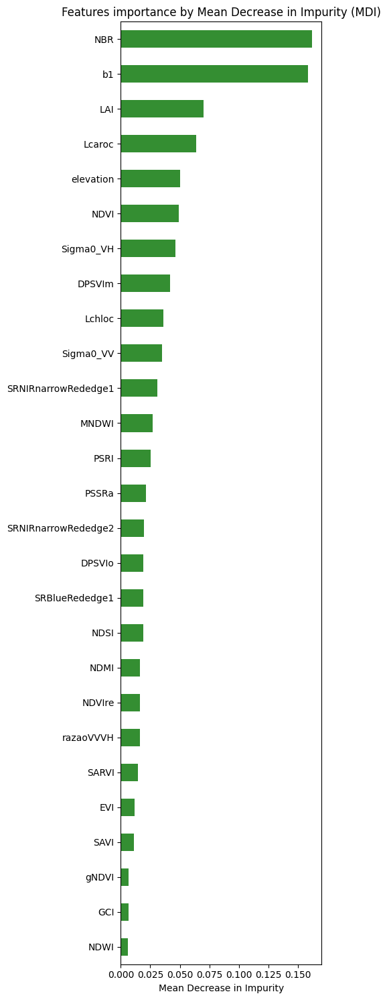

In [ ]:
# Criar uma série com as importâncias médias
RF_feat_importance = pd.Series(mean_values_MDI, index=X.columns)

# Plotar as 39 variáveis mais importantes
RF_feat_importance.nsmallest(39).plot(kind='barh', figsize=(5, 15), color="#348E32")
plt.title('Features importance by Mean Decrease in Impurity (MDI)')
plt.xlabel('Mean Decrease in Impurity')
plt.tight_layout()
plt.show()

## Mean Decrease in Accuracy
Já o MDA avalia a diminuição da acurácia do modelo quando uma feature é removida, fornecendo uma indicação direta do impacto dessa variável na performance do modelo. Ambos os métodos são eficazes para identificar as variáveis mais relevantes, permitindo uma modelagem mais precisa e eficiente da biomassa (Guyon et al. 2003).

In [ ]:
# Inicializar uma lista vazia para armazenar as importâncias das variáveis (MDA)
feature_imps_MDA = []

# Função de validação cruzada com GroupKFold e cálculo das importâncias
for (X_train, y_train), (X_val, y_val) in cross_val(X, y, plot_df, folds=7, random_state=42):

    # Criar o modelo Random Forest
    rf_model = RandomForestRegressor(random_state=42)

    # Ajustar o modelo com os dados de treino
    rf_model.fit(X_train, y_train.values.ravel())

    # Calcular a Permuted Feature Importance (MDA) para o conjunto de treino
    result = permutation_importance(rf_model, X_train, y_train.values.ravel(), n_repeats=30, random_state=42, n_jobs=-1)

    # Armazenar as importâncias das variáveis (MDA) para esse fold
    feature_imps_MDA.append(result['importances_mean'])

# Calcular a média das importâncias das variáveis ao longo de todas as dobras
mean_values_MDA = np.mean(feature_imps_MDA, axis=0)

# Salvar os índices (ordem das colunas) para uso posterior
index_MDA = mean_values_MDA.argsort()


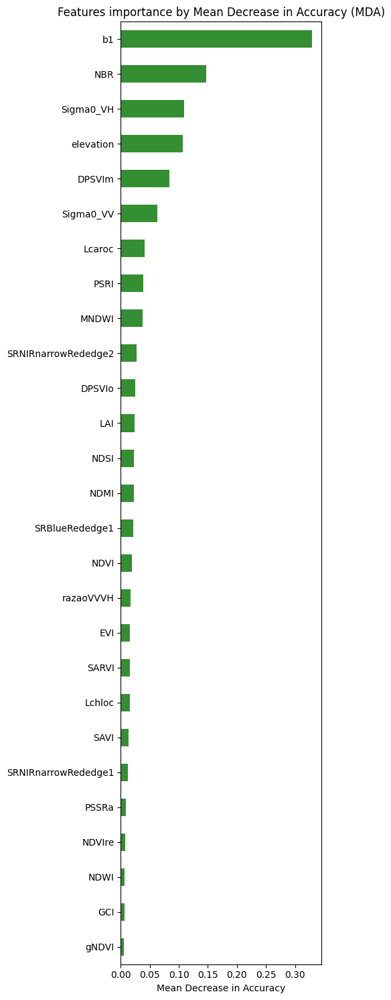

In [ ]:
# Criar uma série com as importâncias médias
RF_feat_importance_MDA = pd.Series(mean_values_MDA, index=X.columns)

# Plotar as 39 variáveis mais importantes
RF_feat_importance_MDA.nsmallest(39).plot(kind='barh', figsize=(5, 15), color="#348E32")
plt.title('Features importance by Mean Decrease in Accuracy (MDA)')
plt.xlabel('Mean Decrease in Accuracy')
plt.tight_layout()
plt.show()

In [ ]:
# create a list with all the feature selection rankings to be tested
index_list = [index_MDI,index_MDA]
# create a list with feature selection methods names
names = ['MDI','MDA']

# 6. Models Fitting

## Random Forest (RF)


### Random Forest: feature selection testing

In [ ]:
# Inicializa uma lista para armazenar os resultados de todos os folds
fold_results = []

# Itera sobre os conjuntos de treino e validação gerados pela função cross_val
for train, val in cross_val(X, y, plot_df, folds=7, random_state=42):

    # Inicializa uma lista para armazenar os resultados do fold atual
    results = []

    # Itera sobre a lista de índices fornecida (index_list)
    for index in index_list:

        # Inicializa uma lista para armazenar os recursos selecionados (features)
        selected_features = []

        # Inicializa uma lista para armazenar os resultados (RMSEs) de cada método no fold
        method_results = []

        # Itera sobre os nomes das colunas de recursos (features) no conjunto de treino
        # O slicing `index[::-1]` inverte a ordem dos índices
        for feature in train[0].columns[index[::-1]]:

            # Adiciona a feature atual à lista de features selecionadas
            selected_features.append(feature)

            # Treina o modelo RandomForestRegressor com as features selecionadas e os valores de treino
            model = RandomForestRegressor(random_state=42).fit(train[0][selected_features], train[1].values.flatten())

            # Faz previsões no conjunto de validação usando as mesmas features selecionadas
            RF_preds = model.predict(val[0][selected_features])

            # Calcula o RMSE entre as previsões e os valores reais de validação
            rmse = np.sqrt(np.mean(np.square(RF_preds - val[1].values.flatten())))

            # Armazena o RMSE para as features selecionadas nesse fold
            method_results.append(rmse)

        # Adiciona os resultados (RMSEs) desse fold para as diferentes combinações de features
        results.append(method_results)

    # Adiciona os resultados desse fold para a lista de todos os folds
    fold_results.append(results)

# Calcula a média dos resultados (RMSEs) ao longo de todos os folds
results = np.mean(fold_results, axis=0)

# Calcula o desvio padrão dos resultados (RMSEs) ao longo dos folds para entender a variabilidade do modelo
error = np.std(fold_results, axis=0)


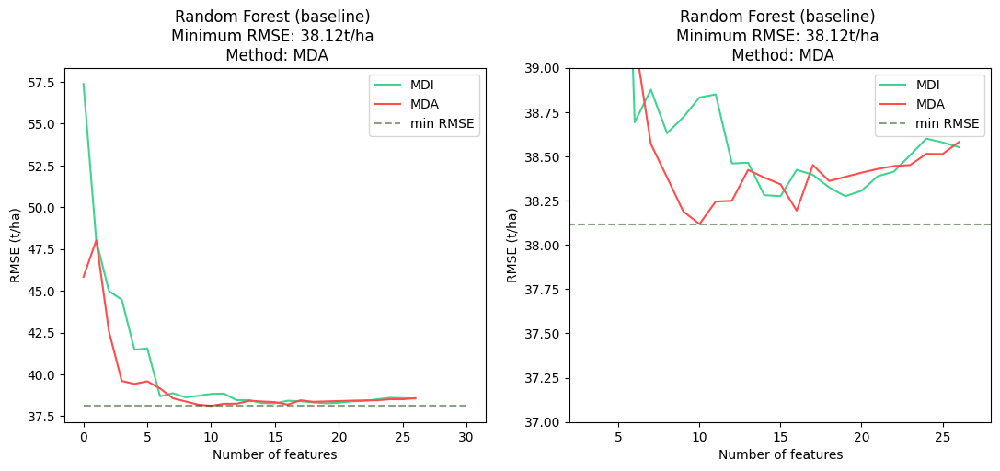

In [ ]:
# plot the feature selection testing w/ RF
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(13,5))

winner = np.argwhere(results == np.min(results)).flatten()[0]

# Change the loop to iterate over the length of the 'names' list
for i in range(len(names)):  # Use len(names) instead of a fixed number
    colors = ["#40d491ff","#ff4d4d"]
    #ax1.fill_between(np.arange(63), results[i]-error[i], results[i]+error[i],alpha=0.15, color=colors[i])
    ax1.plot(results[i],label=names[i], color=colors[i])
ax1.hlines(np.min(results),xmin=0,xmax=30,linestyle='--',color='#25521988',label='min RMSE')
ax1.set_title(f'Random Forest (baseline) \nMinimum RMSE: {np.round(np.min(results),2)}t/ha \n Method: {names[winner]}')
ax1.set_ylabel('RMSE (t/ha)')
ax1.set_xlabel('Number of features')
#plt.ylabel("Root Mean Squared Error")
#ax1.text(63, np.round(np.min(results)), 'Minimum')

ax1.legend(loc='upper right')

# Change the loop to iterate over the length of the 'names' list
for i in range(len(names)):  # Use len(names) instead of a fixed number
    colors = ["#40d491ff","#ff4d4d"]
    #ax2.fill_between(np.arange(63), results[i]-error[i], results[i]+error[i],alpha=0.15, color=colors[i])
    ax2.plot(results[i],label=names[i], color=colors[i])
ax2.hlines(np.min(results),xmin=0,xmax=30,linestyle='--',color='#25521988',label='min RMSE')
ax2.set_title(f'Random Forest (baseline) \nMinimum RMSE: {np.round(np.min(results),2)}t/ha \n Method: {names[winner]}')
ax2.set_ylabel('RMSE (t/ha)')
ax2.set_xlabel('Number of features')
ax2.set_xlim([2,28])
ax2.set_ylim([37,39])
#plt.xlabel("Number of included features")

#ax2.text(2, np.round(np.min(results)), 'Minimum')
ax2.legend(loc='upper right')
fig.show()

In [ ]:
# Crie uma lista das variáveis com melhor desempenho. Tal que, se o modelo de RF com melhor desempenho fosse
# alcançado usando as primeiros 15 variáveis selecionados pelo método de seleção de recursos MDI, crie uma lista com essas variáveis.
rf_X = X[['b1','NBR','Sigma0_VH','elevation','DPSVIm','Sigma0_VV','Lcaroc','PSRI','MNDWI','SRNIRnarrowRededge2']]

### Random Forest: hyper-parameter optimization (Bayesian Search)

In [ ]:
# define a dictionary with hyperparameters to be tested
bayesian_hyperparameters = {"n_estimators": (10,1000),
                        "max_depth": (1,150),
                        "min_samples_split": (2,10),
                        "min_samples_leaf": (1,5)}

In [ ]:
# Função a ser maximizada durante a otimização bayesiana.
# Retorna o valor negativo do RMSE, pois a otimização busca maximizar, e queremos minimizar o RMSE.

def BayesianForest(n_estimators, max_depth, min_samples_split, min_samples_leaf):

    # Inicializa uma lista para armazenar o RMSE de cada fold
    rmse = []

    # Itera sobre os folds gerados pela função cross_val.
    # rf_X: lista das features (X) para o modelo
    # y: variável alvo (AGB)
    # folds=7: número de folds para validação cruzada
    # random_state=42: garante a reprodutibilidade dos resultados.
    for train, val in cross_val(rf_X, y, plot_df, folds=7, random_state=42):

        # Cria um modelo RandomForestRegressor com os parâmetros fornecidos como argumento
        # Parâmetros:
        # - n_estimators: número de árvores na floresta
        # - max_depth: profundidade máxima de cada árvore
        # - min_samples_split: número mínimo de amostras necessárias para dividir um nó
        # - min_samples_leaf: número mínimo de amostras em um nó folha
        model = RandomForestRegressor(
            random_state=42,
            n_estimators=int(n_estimators),  # Converte o número de árvores para inteiro
            max_depth=int(max_depth),  # Converte a profundidade máxima para inteiro
            min_samples_split=int(min_samples_split),  # Converte o valor para inteiro
            min_samples_leaf=int(min_samples_leaf)  # Converte o valor para inteiro
        )

        # Treina o modelo com o conjunto de treino (train[0] são as features, train[1] é a variável alvo)
        model.fit(train[0], train[1].values.flatten())

        # Faz previsões no conjunto de validação (val[0] são as features de validação)
        preds = model.predict(val[0])

        # Calcula o RMSE entre as previsões e os valores reais do conjunto de validação
        rmse.append(np.sqrt(np.mean(np.square(preds - val[1].values.flatten()))))

    # Retorna o valor negativo da média do RMSE calculado em todos os folds.
    # O valor é negativo porque o processo de otimização bayesiana maximiza a função,
    # mas queremos minimizar o RMSE.
    return -np.mean(rmse)

In [ ]:
# Define optimizer
optimizer = BayesianOptimization(
    f=BayesianForest,
    pbounds=bayesian_hyperparameters,
    random_state=42,)

In [ ]:
# Run optimizer !
optimizer.maximize(init_points=20, n_iter=100)

|   iter    |  target   | max_depth | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------
| 23        | -38.06    | 68.95     | 4.141     | 3.597     | 519.1     |
| 24        | -38.09    | 89.27     | 1.186     | 6.86      | 178.8     |
| 25        | -38.02    | 10.69     | 4.796     | 9.725     | 810.3     |
| 26        | -38.04    | 46.39     | 1.391     | 7.474     | 445.8     |
| 27        | -38.05    | 19.18     | 2.981     | 2.275     | 910.2     |
| 28        | -38.05    | 39.56     | 3.65      | 4.494     | 524.9     |
| 29        | -38.05    | 82.46     | 1.739     | 9.757     | 777.4     |
| 30        | -38.06    | 141.0     | 4.579     | 6.783     | 922.7     |
| 31        | -38.1     | 14.19     | 1.784     | 2.362     | 332.1     |
| 32        | -38.08    | 150.0     | 5.0       | 2.0       | 696.6     |
| 33        | -46.3     | 1.0       | 1.0       | 2.0       | 265.9     |
| 34        | -38.1     | 85.24     | 

In [ ]:
# Print optimizer results
print(optimizer.max)

{'target': -38.0205917453276, 'params': {'max_depth': 150.0, 'min_samples_leaf': 1.0, 'min_samples_split': 10.0, 'n_estimators': 628.1996755159697}}


In [ ]:
# Hiperparâmetros otimizados (ajuste conforme os resultados acima)
params = {
    'max_depth': 150,
    'min_samples_leaf': 1,
    'min_samples_split': 10,
    'n_estimators': 628
}

# Função para ajustar e validar o modelo usando validação cruzada com GroupKFold
def cross_val_rf_tuned(X, y, plot_df, folds=7, random_state=42, params=params):
    '''
    Executa a validação cruzada para o modelo RandomForestRegressor utilizando os hiperparâmetros otimizados.

    X: Variáveis independentes (DataFrame)
    y: Variável dependente (AGB) (DataFrame ou Series)
    plot_df: DataFrame com os identificadores de parcelas (deve conter a coluna 'plot_number')
    folds: Número de divisões para a validação cruzada
    random_state: Seed para a reprodução dos resultados
    params: Dicionário com os hiperparâmetros otimizados
    '''

    # Configuração de GroupKFold para garantir que parcelas inteiras sejam usadas em treino/validação
    gkf = GroupKFold(n_splits=folds)

    # Armazena os resultados de cada fold
    rmse_scores = []
    r2_scores = []
    mae_scores = []

    # Itera sobre os folds
    for train_idx, val_idx in gkf.split(X, y, groups=plot_df['plot_number']):

        # Divide os dados em treino e validação com base nos índices dos folds
        X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

        # Ajusta o RobustScaler apenas no conjunto de treino
        scaler = RobustScaler().fit(X_train)

        # Escala os conjuntos de treino e validação
        X_train = pd.DataFrame(scaler.transform(X_train), columns=X.columns)
        X_val = pd.DataFrame(scaler.transform(X_val), columns=X.columns)

        # Define o modelo com os hiperparâmetros otimizados
        model = RandomForestRegressor(
            max_depth=params['max_depth'],
            min_samples_leaf=params['min_samples_leaf'],
            min_samples_split=params['min_samples_split'],
            n_estimators=params['n_estimators'],
            random_state=random_state
        )

        # Ajusta o modelo aos dados de treino
        model.fit(X_train, y_train)

        # Avaliar o modelo no conjunto de validação
        y_pred = model.predict(X_val).flatten()

        # Convert y_val to a NumPy array and extract values
        y_val_values = y_val.values.ravel()  # or y_val.to_numpy().ravel()

        rmse = np.sqrt(np.mean((y_val_values - y_pred) ** 2)) # Use y_val_values
        r2 = 1 - (np.sum((y_val_values - y_pred) ** 2) / np.sum((y_val_values - np.mean(y_val_values)) ** 2))  # Use y_val_values
        mae = np.mean(np.abs(y_val_values - y_pred))  # Use y_val_values

        # # Faz previsões nos dados de validação
        # y_pred = model.predict(X_val)

        # # Calcula o RMSE e R² para o fold atual
        # rmse = mean_squared_error(y_val, y_pred, squared=False)  # Raiz do erro quadrático médio (RMSE)
        # r2 = r2_score(y_val, y_pred)  # Coeficiente de determinação (R²)
        # mae = mean_absolute_error(y_val, y_pred)  # Erro médio absoluto (MAE)

        # Armazena as métricas
        rmse_scores.append(rmse)
        r2_scores.append(r2)
        mae_scores.append(mae)

        # Exibe os resultados para o fold atual
        print(f"Fold RMSE: {rmse:.4f}, R²: {r2:.4f}, MAE:{mae:.4f}")

    # Exibe as médias das métricas de todos os folds
    print(f"\nValidação cruzada concluída.")
    print(f"Média RMSE: {np.mean(rmse_scores):.4f}")
    print(f"Média R²: {np.mean(r2_scores):.4f}")
    print(f"Média MAE: {np.mean(mae_scores):.4f}")

# Exemplo de uso da função (substitua rf_X, y, e plot_df pelos seus dados)
cross_val_rf_tuned(rf_X, y, plot_df)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 32.9101, R²: 0.7163, MAE:26.2112


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 37.7638, R²: 0.5628, MAE:29.2574


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 36.8383, R²: 0.6737, MAE:29.4010


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 39.4937, R²: 0.6686, MAE:30.6509


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 37.0059, R²: 0.6080, MAE:30.1254


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 39.2890, R²: 0.6628, MAE:31.1986


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Fold RMSE: 42.8434, R²: 0.5157, MAE:32.9710

Validação cruzada concluída.
Média RMSE: 38.0206
Média R²: 0.6297
Média MAE: 29.9736


## Deep Neural Networks (DNN)

### Deep Neural Network: feature selection testing

In [ ]:
def feature_selection_nn(X, y, plot_df, n_features, folds=7, epochs=50, batch_size=32):
    '''
    Função para selecionar features incrementalmente e calcular o RMSE em cada etapa,
    usando validação cruzada (GroupKFold).

    X: DataFrame com as variáveis independentes.
    y: DataFrame com a variável dependente.
    plot_df: DataFrame contendo os identificadores das parcelas (usado no GroupKFold).
    n_features: Lista de índices das features para serem usadas.
    folds: Número de divisões para a validação cruzada.
    epochs: Número de épocas para o treinamento da rede neural.
    batch_size: Tamanho do lote para o treinamento.
    '''

    # Inicializar KFold
    kf = GroupKFold(n_splits=folds)

    # Lista para armazenar os resultados dos RMSE para cada combinação de features
    plex_results = []

    # Escalar os dados
    scaler = RobustScaler().fit(X)
    X_scaled = pd.DataFrame(scaler.transform(X), columns=X.columns)

    # Loop sobre os índices das features
    for index in n_features:
        selected_features = X_scaled.columns[:index+1]
        fold_rmse = []

        # Validação cruzada
        for train_idx, val_idx in kf.split(X, y, groups=plot_df['plot_number']):
            X_train, X_val = X_scaled.iloc[train_idx][selected_features], X_scaled.iloc[val_idx][selected_features]
            y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

            # Definir a arquitetura da rede neural
            model = Sequential()
            model.add(Input(shape=(X_train.shape[1],)))
            model.add(Dense(units=128, activation='relu'))
            model.add(Dropout(0.3))
            model.add(Dense(units=64, activation='relu'))
            model.add(Dense(units=32, activation='relu'))
            model.add(Dropout(0.1))
            model.add(Dense(units=16, activation='relu'))
            model.add(Dense(units=8, activation='relu'))
            model.add(Dense(units=1, activation='linear'))

            model.compile(loss='mse', optimizer='adam')

            # Early stopping
            early_stopping = EarlyStopping(monitor='loss', patience=3, restore_best_weights=True)

            # Treinar o modelo
            model.fit(X_train, y_train.values.flatten(), batch_size=batch_size, epochs=epochs, verbose=0, callbacks=[early_stopping])

            # Previsão no conjunto de validação
            y_pred = model.predict(X_val).flatten()

            # Calcular RMSE
            rmse = np.sqrt(np.mean(np.square(y_pred - y_val.values.flatten())))
            fold_rmse.append(rmse)

        # Média do RMSE dos folds
        plex_results.append(np.mean(fold_rmse))

    return plex_results


In [ ]:
# Definir lista de índices de features (por exemplo, 10 primeiros)
n_features = list(range(27))  # Testar até as 10 primeiras features
plex_results = feature_selection_nn(X, y, plot_df, n_features)

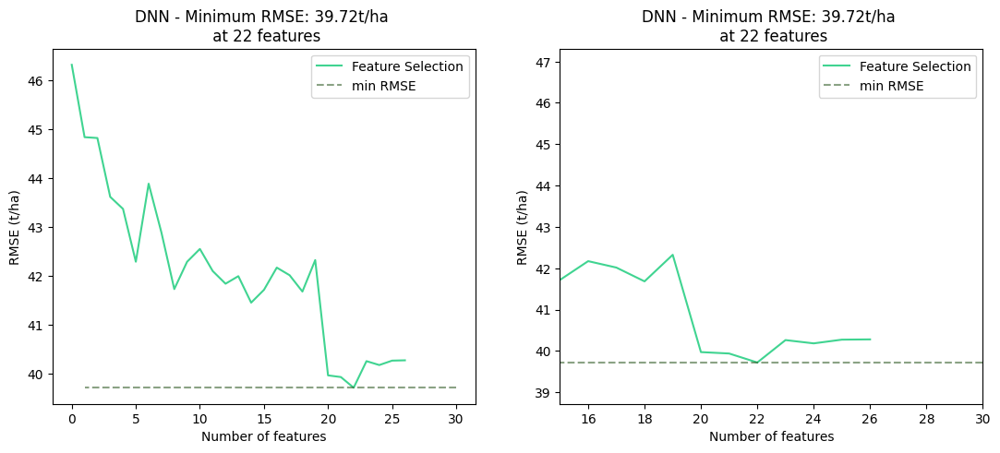

In [ ]:
# Plotar os resultados de RMSE em função do número de features
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 5))

# Identifica o "vencedor", ou seja, o índice da combinação de features com o menor RMSE
winner = np.argmin(plex_results)

# Plotar o RMSE para cada número de features em ax1
ax1.plot(plex_results, label="Feature Selection", color="#40d491ff")
ax1.hlines(np.min(plex_results), xmin=30, xmax=len(index_list)-1, linestyle='--', color='#25521988', label='min RMSE')

ax1.set_title(f'DNN - Minimum RMSE: {np.round(np.min(plex_results), 2)}t/ha \n at {winner} features')
ax1.set_ylabel('RMSE (t/ha)')
ax1.set_xlabel('Number of features')
ax1.legend(loc='upper right')

# Ajustes no segundo gráfico (zoom)
ax2.plot(plex_results, label="Feature Selection", color="#40d491ff")
ax2.hlines(np.min(plex_results), xmin=30, xmax=len(index_list)-1, linestyle='--', color='#25521988', label='min RMSE')

ax2.set_xlim([15, 30])
ax2.set_ylim([min(plex_results) - 1, max(plex_results) + 1])
ax2.set_title(f'DNN - Minimum RMSE: {np.round(np.min(plex_results), 2)}t/ha \n at {winner} features')
ax2.set_ylabel('RMSE (t/ha)')
ax2.set_xlabel('Number of features')
ax2.legend(loc='upper right')

plt.show()


In [ ]:
X.columns

In [ ]:
# Cria uma lista considerando a seleção de variáveis pelo ranking do método vencedor
dnn_X = X[['b1', 'EVI', 'MNDWI', 'NBR', 'NDMI', 'NDVI', 'NDWI', 'SAVI',
       'elevation', 'gNDVI', 'NDVIre', 'SRBlueRededge1', 'SRNIRnarrowRededge1',
       'SRNIRnarrowRededge2', 'PSSRa', 'GCI', 'Lcaroc', 'Lchloc', 'PSRI',
       'LAI', 'Sigma0_VV', 'Sigma0_VH']]

### Deep Neural Network: hyper-parameter optimization (Random Search)

In [ ]:
# Função para construir o modelo, ajustando os hiperparâmetros com Keras Tuner
def build_model(hp):
    model = Sequential()

    # Ajustar número de neurônios da primeira camada oculta

    model.add(Input(shape=(22,))) # Número de features

    model.add(Dense(units=hp.Int('units_layer1', min_value=128, max_value=256, step=16),
                    activation='relu'))

    # Ajustar taxa de dropout da primeira camada
    model.add(Dropout(rate=hp.Float('dropout_layer1', min_value=0.0, max_value=0.5, step=0.1)))

    # Ajustar número de neurônios da segunda camada oculta
    model.add(Dense(units=hp.Int('units_layer2', min_value=64, max_value=128, step=4),
                    activation='relu'))

    model.add(Dense(units=hp.Int('units_layer3', min_value=32, max_value=64, step=4),
                    activation='relu'))

    # Ajustar taxa de dropout da segunda camada
    model.add(Dropout(rate=hp.Float('dropout_layer2', min_value=0.0, max_value=0.5, step=0.1)))

    # Ajustar número de neurônios da segunda camada oculta
    model.add(Dense(units=hp.Int('units_layer4', min_value=16, max_value=32, step=2),
                    activation='relu'))

    model.add(Dense(units=hp.Int('units_layer5', min_value=8, max_value=16, step=2),
                    activation='relu'))

    # Camada de saída
    model.add(Dense(units=1, activation='linear'))

    # Ajustar a taxa de aprendizado do otimizador Adam
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='log')),
                  loss='mean_squared_error')

    return model


In [ ]:
# Função para fazer tuning dos hiperparâmetros com validação cruzada
def cross_val_tuning(X, y, plot_df, folds=7, random_state=42, epochs=50, batch_size=32):

    # Inicializar KFold com GroupKFold
    kf = GroupKFold(n_splits=folds)

    # Escalonar os dados com RobustScaler
    for train_index, val_index in kf.split(X, y, groups=plot_df['plot_number']):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        # Escalar os dados
        scaler = RobustScaler().fit(X_train)
        X_train = pd.DataFrame(scaler.transform(X_train), columns=X.columns)
        X_val = pd.DataFrame(scaler.transform(X_val), columns=X.columns)

        # Definir o tuner (Random Search)
        tuner = kt.RandomSearch(
            build_model,
            objective='loss',
            max_trials=20,  # Número de combinações de hiperparâmetros a testar
            executions_per_trial=1,  # Quantas vezes executar para cada combinação de hiperparâmetros
            directory='tuner_results',  # Onde salvar os resultados
            project_name='nn_hyperparameter_tuning'
        )

        # Parâmetros de ajuste do modelo
        tuner.search(X_train, y_train,
                     epochs=epochs,
                     validation_data=(X_val, y_val),
                     batch_size=batch_size,
                     verbose=0)

        # Recuperar os melhores hiperparâmetros encontrados
        best_hp = tuner.get_best_hyperparameters(num_trials=3)[0]

        # Mostrar os hiperparâmetros otimizados
        print(f"Best units layer 1: {best_hp.get('units_layer1')}")
        print(f"Best dropout layer 1: {best_hp.get('dropout_layer1')}")
        print(f"Best units layer 2: {best_hp.get('units_layer2')}")
        print(f"Best units layer 3: {best_hp.get('units_layer3')}")
        print(f"Best dropout layer 2: {best_hp.get('dropout_layer2')}")
        print(f"Best units layer 4: {best_hp.get('units_layer4')}")
        print(f"Best units layer 5: {best_hp.get('units_layer5')}")
        print(f"Best learning rate: {best_hp.get('learning_rate')}")

        # Construir o modelo final com os melhores hiperparâmetros e treinar
        best_model = tuner.hypermodel.build(best_hp)
        best_model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

        # Fazer previsões no conjunto de validação
        y_pred = best_model.predict(X_val).flatten()

        # Calcular RMSE e R²
        # Extract the 'AGB' column from y_val as a NumPy array
        rmse = np.sqrt(np.mean((y_val['AGB'].values - y_pred) ** 2))
        r2 = 1 - (np.sum((y_val['AGB'].values - y_pred) ** 2) / np.sum((y_val['AGB'].values - np.mean(y_val['AGB'].values)) ** 2))
        mae = np.mean(np.abs(y_val['AGB'].values - y_pred))  # Cálculo do MAE

        print(f"Fold RMSE: {rmse:.4f}, R²: {r2:.4f}",'Média MAE: {mean_mae:.4f}')

    return best_model

In [ ]:
# Execute a função:
best_model = cross_val_tuning(dnn_X, y, plot_df)

Reloading Tuner from tuner_results/nn_hyperparameter_tuning/tuner0.json
Best units layer 1: 128
Best dropout layer 1: 0.0
Best units layer 2: 80
Best units layer 3: 48
Best dropout layer 2: 0.2
Best units layer 4: 20
Best units layer 5: 8
Best learning rate: 0.0013374133933164007
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Fold RMSE: 36.3902, R²: 0.6531 Média MAE: {mean_mae:.4f}
Reloading Tuner from tuner_results/nn_hyperparameter_tuning/tuner0.json
Best units layer 1: 128
Best dropout layer 1: 0.0
Best units layer 2: 80
Best units layer 3: 48
Best dropout layer 2: 0.2
Best units layer 4: 20
Best units layer 5: 8
Best learning rate: 0.0013374133933164007
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Fold RMSE: 38.4828, R²: 0.5460 Média MAE: {mean_mae:.4f}
Reloading Tuner from tuner_results/nn_hyperparameter_tuning/tuner0.json
Best units layer 1: 128
Best dropout layer 1: 0.0
Best units layer 2: 80
Best units layer 3: 48
Best dropout layer 2: 0.2
Best units layer 4: 20
Best units layer 5: 8
Best lear

In [ ]:
def cross_val_dnn_tuned(X, y, plot_df, folds=7, random_state=42, epochs=50, batch_size=32):
    '''
    Executa a validação cruzada para uma rede neural em um problema de regressão.

    X: DataFrame com as variáveis independentes.
    y: DataFrame com a variável dependente (AGB).
    plot_df: DataFrame contendo os identificadores das parcelas.
    folds: Número de divisões para a validação cruzada.
    random_state: Semente para reprodução dos resultados.
    epochs: Número de épocas para o treinamento da rede neural.
    batch_size: Tamanho do lote para o treinamento.
    '''

    # Inicializar KFold com embaralhamento
    kf = GroupKFold(n_splits=folds)

    # Listas para armazenar métricas de cada fold
    rmse_scores = []
    r2_scores = []
    mae_scores = []  # Lista para armazenar os valores de MAE

    # Iterar sobre os folds
    for train_index, val_index in kf.split(X, y, groups=plot_df['plot_number']):
        # Dividir os dados em treino e validação
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        # Escalonar os dados
        scaler = RobustScaler().fit(X_train)
        X_train = pd.DataFrame(scaler.transform(X_train), columns=X.columns)
        X_val = pd.DataFrame(scaler.transform(X_val), columns=X.columns)

        # Definir a arquitetura da rede neural
        model = Sequential()
        model.add(Input(shape=(X_train.shape[1],)))
        model.add(Dense(units=128, activation='relu'))
        model.add(Dropout(0.0))
        model.add(Dense(units=80, activation='relu'))
        model.add(Dense(units=48, activation='relu'))
        model.add(Dropout(0.2))
        model.add(Dense(units=20, activation='relu'))
        model.add(Dense(units=8, activation='relu'))
        model.add(Dense(units=1, activation='linear'))


        # Compilar o modelo
        model.compile(optimizer=keras.optimizers.Adam(learning_rate= 0.0013), loss='mean_squared_error', metrics=[RootMeanSquaredError()])

        # Adiciona um parâmetro de parada caso o desempenho não melhore
        stop = EarlyStopping(monitor='loss', patience=3)

        # Treinar o modelo
        model.fit(X_train, y_train, epochs=epochs, callbacks = [stop], batch_size=batch_size, verbose=0)

        # Avaliar o modelo no conjunto de validação
        y_pred = model.predict(X_val).flatten()

        # Convert y_val to a NumPy array and extract values
        y_val_values = y_val.values.ravel()  # or y_val.to_numpy().ravel()

        rmse = np.sqrt(np.mean((y_val_values - y_pred) ** 2)) # Use y_val_values
        r2 = 1 - (np.sum((y_val_values - y_pred) ** 2) / np.sum((y_val_values - np.mean(y_val_values)) ** 2))  # Use y_val_values
        mae = np.mean(np.abs(y_val_values - y_pred))  # Cálculo do MAE

        # Armazenar as métricas
        rmse_scores.append(rmse)
        r2_scores.append(r2)
        mae_scores.append(mae)  # Armazenar MAE

        print(f'Fold RMSE: {rmse:.4f}, R²: {r2:.4f}, MAE: {mae:.4f}')  # Exibir MAE

    # Calcular as métricas médias
    mean_rmse = np.mean(rmse_scores)
    mean_r2 = np.mean(r2_scores)
    mean_mae = np.mean(mae_scores)  # Média do MAE

    print(f'Validação cruzada concluída. Média RMSE: {mean_rmse:.4f}, Média R²: {mean_r2:.4f}, Média MAE: {mean_mae:.4f}')  # Exibir MAE

    return model


In [ ]:
# Execute a função utilizando a lista de variáveis selecionadas no teste
cross_val_dnn_tuned(dnn_X, y, plot_df)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
Fold RMSE: 31.9732, R²: 0.7322, MAE: 24.9855
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Fold RMSE: 39.5940, R²: 0.5194, MAE: 31.4502
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Fold RMSE: 36.7710, R²: 0.6749, MAE: 29.1353
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
Fold RMSE: 39.4938, R²: 0.6686, MAE: 31.5926
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Fold RMSE: 38.4945, R²: 0.5758, MAE: 31.7067
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Fold RMSE: 39.6944, R²: 0.6558, MAE: 32.1219
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
Fold RMSE: 45.9775, R²: 0.4423, MAE: 36.8481
Validação cruzada concluída. Média RMSE: 38.8569, Média R²: 0.6099, Média MAE: 31.1200


<Sequential name=sequential_60, built=True>

## XGBoosting (XGB)

### XGBoosting: feature selection testing

In [ ]:
fold_results = []  # Lista para armazenar os resultados de cada fold da validação cruzada
for train, val in cross_val(X, y, plot_df, folds=7, random_state=42):  # Loop pelos folds da validação cruzada (neste caso, 7 folds)
    results = []  # Lista para armazenar os resultados de cada método por fold
    for index in index_list:  # Loop pelos índices (index_list define subconjuntos de recursos)
        selected_features = []  # Lista para armazenar as features selecionadas no loop atual
        method_results = []  # Lista para armazenar os resultados do RMSE para cada subconjunto de features
        for feature in train[0].columns[index[::-1]]:  # Percorre as features de um determinado subset, em ordem inversa
            selected_features.append(feature)  # Adiciona a feature selecionada ao conjunto de features

            # Inicializa o modelo XGBoost com random_state para reprodutibilidade, e define RMSE como métrica de avaliação
            model = xgboost.XGBRegressor(random_state=42, eval_metric='rmse')

            # Treina o modelo nas features selecionadas do conjunto de treino e valida com o conjunto de validação
            model.fit(train[0][selected_features], train[1].values.flatten(),
                      eval_set=[(val[0][selected_features], val[1].values.flatten())], verbose=False)

            # Faz as previsões no conjunto de validação
            preds = model.predict(val[0][selected_features])

            # Calcula o RMSE (Root Mean Squared Error) entre as previsões e os valores reais
            rmse = np.sqrt(np.mean(np.square(preds - val[1].values.flatten())))

            method_results.append(rmse)  # Armazena o RMSE calculado para o conjunto de features selecionado
        results.append(method_results)  # Armazena os resultados (RMSE) de todos os subsets de features testados
    fold_results.append(results)  # Armazena os resultados do fold atual

# Calcula a média dos resultados ao longo de todos os folds para cada método
results = np.mean(fold_results, axis=0)


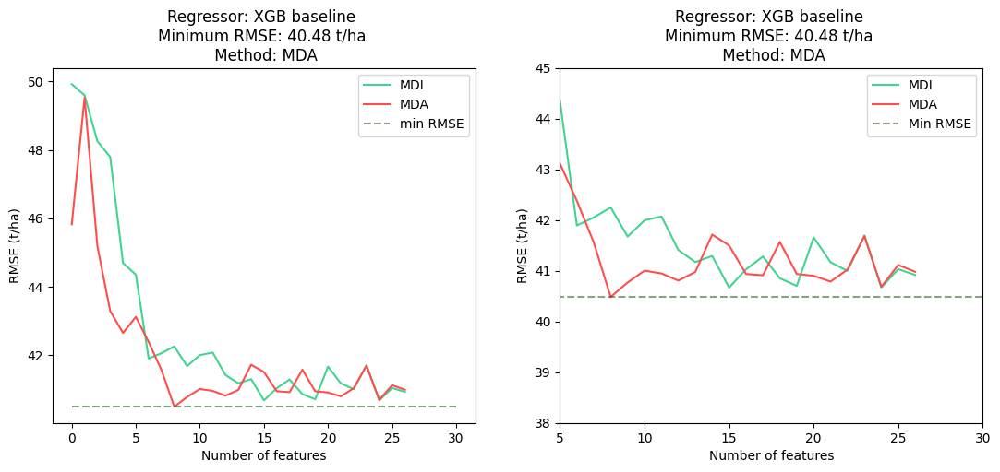

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(13,5))

winner = np.argwhere(results == np.min(results)).flatten()[0]

for i in range(2):
    colors = ["#40d491ff","#ff4d4d"]
    ax1.plot(results[i],label=names[i], color=colors[i])
ax1.hlines(np.min(results),xmin=0,xmax=30,linestyle='--',color='#25521988',label='min RMSE')
ax1.set_title(f'Regressor: XGB baseline \nMinimum RMSE: {np.round(np.min(results),2)} t/ha \n Method: {names[winner]}')
ax1.set_ylabel('RMSE (t/ha)')
ax1.set_xlabel('Number of features')


ax1.legend(loc='upper right')

for i in range(2):
    colors = ["#40d491ff","#ff4d4d"]
    ax2.plot(results[i],label=names[i], color=colors[i])
ax2.hlines(np.min(results),xmin=0,xmax=30,linestyle='--',color='#25521988',label='Min RMSE')
ax2.set_title(f'Regressor: XGB baseline \nMinimum RMSE: {np.round(np.min(results),2)} t/ha \n Method: {names[winner]}')
ax2.set_xlim([5,30])
ax2.set_ylim([38,45])
ax2.set_ylabel('RMSE (t/ha)')
ax2.set_xlabel('Number of features')

ax2.legend(loc='upper right')
fig.show()

In [ ]:
xgb_X = X[['b1','NBR','Sigma0_VH','elevation','DPSVIm','Sigma0_VV','Lcaroc','PSRI']]

### XGBoosting: hyper-parameters optimization (Bayesian Search)

In [ ]:
# Define a dictionary with hyperparameters to be tested
hy_params = {"alpha": (0,0.9), 'subsample': (0,1),'gamma': (0, 0.9),'learning_rate':(0,0.9),'n_estimators':(30,1000), "max_depth": (1,8)}

In [ ]:
# Define function to be maximized (negative RMSE)
def BayesianForest(max_depth, gamma, n_estimators ,learning_rate, alpha, subsample):
    rmse = []
    for train, val in cross_val(xgb_X,y,plot_df,folds=7):

        model = xgboost.XGBRegressor(alpha = int(alpha), max_depth = int(max_depth),
              gamma = gamma,
              n_estimators= int(n_estimators),
              learning_rate=learning_rate, subsample = subsample,
              eval_metric = 'rmse', random_state=42)

        model.fit(train[0], train[1].values.flatten(),verbose=False)

        preds = model.predict(val[0])
        rmse.append(np.sqrt(np.mean(np.square(preds-val[1].values.flatten()))))

    return -np.mean(rmse)

In [ ]:
# define optimizer
optimizer = BayesianOptimization(
    f=BayesianForest, pbounds=hy_params
    )

In [ ]:
# run it
optimizer.maximize(init_points=20, n_iter=100)

In [ ]:
# print hyperparameters that maximise the -RMSE
print(optimizer.max)

{'target': -38.30096333898704, 'params': {'alpha': 0.40204843966733234, 'gamma': 0.8632797736138497, 'learning_rate': 0.08316962222432826, 'max_depth': 1.2510204647086418, 'n_estimators': 537.5132240558205, 'subsample': 0.9638446022567497}}


In [ ]:
# Hiperparâmetros otimizados para o XGBoost
params = {
    'alpha': 0.40204843966733234,
    'gamma': 0.8632797736138497,
    'learning_rate': 0.08316962222432826,
    'max_depth': 1,
    'n_estimators': 537,
    'subsample': 0.9638446022567497
}

# Função para ajustar e validar o modelo XGBoost usando validação cruzada com GroupKFold
def cross_val_xgb_tuned(X, y, plot_df, folds=7, random_state=42, params=params):
    '''
    Executa a validação cruzada para o modelo XGBoostRegressor utilizando os hiperparâmetros otimizados.

    X: Variáveis independentes (DataFrame)
    y: Variável dependente (AGB) (DataFrame ou Series)
    plot_df: DataFrame com os identificadores de parcelas (deve conter a coluna 'plot_number')
    folds: Número de divisões para a validação cruzada
    random_state: Seed para a reprodução dos resultados
    params: Dicionário com os hiperparâmetros otimizados
    '''

    # Configuração de GroupKFold para garantir que parcelas inteiras sejam usadas em treino/validação
    gkf = GroupKFold(n_splits=folds)

    # Armazena os resultados de cada fold
    rmse_scores = []
    r2_scores = []
    mae_scores = []

    # Itera sobre os folds
    for train_idx, val_idx in gkf.split(X, y, groups=plot_df['plot_number']):

        # Divide os dados em treino e validação com base nos índices dos folds
        X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

        # Ajusta o RobustScaler apenas no conjunto de treino
        scaler = RobustScaler().fit(X_train)

        # Escala os conjuntos de treino e validação
        X_train = pd.DataFrame(scaler.transform(X_train), columns=X.columns)
        X_val = pd.DataFrame(scaler.transform(X_val), columns=X.columns)

        # Define o modelo XGBoost com os hiperparâmetros otimizados
        model = xgboost.XGBRegressor(
            alpha=params['alpha'],
            gamma=params['gamma'],
            learning_rate=params['learning_rate'],
            max_depth=params['max_depth'],
            n_estimators=params['n_estimators'],
            subsample=params['subsample'],
            random_state=random_state
        )

        # Ajusta o modelo aos dados de treino
        model.fit(X_train, y_train)

        # Faz previsões nos dados de validação
        y_pred = model.predict(X_val)

        # Calcula o RMSE, R² e MAE para o fold atual
        # rmse = mean_squared_error(y_val, y_pred, squared=False)  # Raiz do erro quadrático médio (RMSE)
        rmse = root_mean_squared_error(y_val,y_pred)
        r2 = r2_score(y_val, y_pred)  # Coeficiente de determinação (R²)
        mae = mean_absolute_error(y_val, y_pred)  # Erro médio absoluto (MAE)

        # Armazena as métricas
        rmse_scores.append(rmse)
        r2_scores.append(r2)
        mae_scores.append(mae)

        # Exibe os resultados para o fold atual
        print(f"Fold RMSE: {rmse:.4f}, R²: {r2:.4f}, MAE:{mae:.4f}")

    # Exibe as médias das métricas de todos os folds
    print(f"\nValidação cruzada concluída.")
    print(f"Média RMSE: {np.mean(rmse_scores):.4f}")
    print(f"Média R²: {np.mean(r2_scores):.4f}")
    print(f"Média MAE: {np.mean(mae_scores):.4f}")

# Exemplo de uso da função (substitua xgb_X, y, e plot_df pelos seus dados)
cross_val_xgb_tuned(xgb_X, y, plot_df)


Fold RMSE: 32.1669, R²: 0.7289, MAE:25.2695
Fold RMSE: 38.7952, R²: 0.5386, MAE:30.9247
Fold RMSE: 37.3860, R²: 0.6640, MAE:30.2051
Fold RMSE: 39.1908, R²: 0.6737, MAE:30.7114
Fold RMSE: 38.7110, R²: 0.5710, MAE:31.6265
Fold RMSE: 39.1504, R²: 0.6652, MAE:30.9823
Fold RMSE: 42.6983, R²: 0.5190, MAE:32.9487

Validação cruzada concluída.
Média RMSE: 38.2998
Média R²: 0.6229
Média MAE: 30.3812


# 7. Accuracy Assessment

tabelas comparativas das métricas
gráficos?


In [ ]:
# rf_r2 = r2_score(y, rf_y_pred)

rf_r2 = 0.6297
xgb_r2 = 0.6229
dnn_r2 = 0.61

# Número de observações e preditores
n = X.shape[0]
p_rf = rf_X.shape[1]
p_xgb = xgb_X.shape[1]
p_dnn = dnn_X.shape[1]

# Cálculo do R² ajustado
rf_r2_adjusted = 1 - ((1 - rf_r2) * (n - 1) / (n - p_rf - 1))
xgb_r2_adjusted = 1 - ((1 - xgb_r2) * (n - 1) / (n - p_xgb - 1))
dnn_r2_adjusted = 1 - ((1 - dnn_r2) * (n - 1) / (n - p_dnn - 1))

print(f'R² Ajustado para Random Forest: {rf_r2_adjusted}')
print(f'R² Ajustado para XGBoosting: {xgb_r2_adjusted}')
print(f'R² Ajustado para Deep Neural Network: {dnn_r2_adjusted}')

R² Ajustado para Random Forest: 0.6272765706806283
R² Ajustado para XGBoosting: 0.6209282352941177
R² Ajustado para Deep Neural Network: 0.6043403693931397


In [ ]:
# Resultados dos modelos
rf_rmse = [32.9101, 37.7638, 36.8383, 39.4937, 37.0059, 39.2890, 42.8434]
dnn_rmse = [31.9732, 39.5940, 36.7710, 39.4938, 38.4945, 39.6944, 45.9775]
xgb_rmse = [32.1669, 38.7952, 37.3860, 39.1908, 38.7110, 39.1504, 42.6983]

rf_mae = [26.2112, 29.2574, 29.4010, 30.6509, 30.1254, 31.1986, 32.9710]
dnn_mae = [24.9855, 31.4502, 29.1353, 31.5926, 31.7067, 32.1219, 36.8481]
xgb_mae = [25.2695, 30.9247, 30.2051, 30.7114, 31.6265, 30.9823, 32.9487]

rf_r2 = [0.7163, 0.5628, 0.6737, 0.6686, 0.6080, 0.6628, 0.5157]
dnn_r2 = [0.7322, 0.5194, 0.6749, 0.6686, 0.5758, 0.6558, 0.4423]
xgb_r2 = [0.7289, 0.5386, 0.6640, 0.6737, 0.5710, 0.6652, 0.5190]



Mann-Whitney Test - RF vs DNN RMSE: Statistics=19.0, p-value=0.535
Mann-Whitney Test - RF vs XGB RMSE: Statistics=24.0, p-value=1.000
Mann-Whitney Test - DNN vs XGB RMSE: Statistics=28.0, p-value=0.710

Mann-Whitney Test - RF vs DNN MAE: Statistics=17.0, p-value=0.383
Mann-Whitney Test - RF vs XGB MAE: Statistics=18.0, p-value=0.456
Mann-Whitney Test - DNN vs XGB MAE: Statistics=30.0, p-value=0.535

Mann-Whitney Test - RF vs DNN R²: Statistics=25.5, p-value=0.949
Mann-Whitney Test - RF vs XGB R²: Statistics=24.5, p-value=1.000
Mann-Whitney Test - DNN vs XGB R²: Statistics=25.0, p-value=1.000


In [ ]:
folds = np.arange(1, 8)  # Número de folds

In [ ]:
# Configuração do layout do gráfico
fig, axs = plt.subplots(3, 1, figsize=(10, 12), sharex=True)

# Gráfico de RMSE
axs[0].plot(folds, rf_rmse, label="Random Forest", marker="o", color="blue")
axs[0].plot(folds, dnn_rmse, label="DNN", marker="s", color="orange")
axs[0].plot(folds, xgb_rmse, label="XGBoost", marker="^", color="green")
axs[0].set_title("RMSE per Fold")
axs[0].set_ylabel("RMSE")
axs[0].legend()
axs[0].grid(True)

# Gráfico de MAE
axs[1].plot(folds, rf_mae, label="Random Forest", marker="o", color="blue")
axs[1].plot(folds, dnn_mae, label="DNN", marker="s", color="orange")
axs[1].plot(folds, xgb_mae, label="XGBoost", marker="^", color="green")
axs[1].set_title("MAE per Fold")
axs[1].set_ylabel("MAE")
axs[1].legend()
axs[1].grid(True)

# Gráfico de R²
axs[2].plot(folds, rf_r2, label="Random Forest", marker="o", color="blue")
axs[2].plot(folds, dnn_r2, label="DNN", marker="s", color="orange")
axs[2].plot(folds, xgb_r2, label="XGBoost", marker="^", color="green")
axs[2].set_title("R² per Fold")
axs[2].set_xlabel("Fold")
axs[2].set_ylabel("R²")
axs[2].legend()
axs[2].grid(True)

# Ajuste do layout
plt.tight_layout()
plt.show()

In [ ]:
# Teste Mann-Whitney para RMSE
mann_whitney_rf_dnn_rmse = mannwhitneyu(rf_rmse, dnn_rmse)
mann_whitney_rf_xgb_rmse = mannwhitneyu(rf_rmse, xgb_rmse)
mann_whitney_dnn_xgb_rmse = mannwhitneyu(dnn_rmse, xgb_rmse)

# Teste Mann-Whitney para MAE
mann_whitney_rf_dnn_mae = mannwhitneyu(rf_mae, dnn_mae)
mann_whitney_rf_xgb_mae = mannwhitneyu(rf_mae, xgb_mae)
mann_whitney_dnn_xgb_mae = mannwhitneyu(dnn_mae, xgb_mae)

# Teste Mann-Whitney para R²
mann_whitney_rf_dnn_r2 = mannwhitneyu(rf_r2, dnn_r2)
mann_whitney_rf_xgb_r2 = mannwhitneyu(rf_r2, xgb_r2)
mann_whitney_dnn_xgb_r2 = mannwhitneyu(dnn_r2, xgb_r2)

# Resultados
print("Mann-Whitney Test - RF vs DNN RMSE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_dnn_rmse.statistic, mann_whitney_rf_dnn_rmse.pvalue))
print("Mann-Whitney Test - RF vs XGB RMSE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_xgb_rmse.statistic, mann_whitney_rf_xgb_rmse.pvalue))
print("Mann-Whitney Test - DNN vs XGB RMSE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_dnn_xgb_rmse.statistic, mann_whitney_dnn_xgb_rmse.pvalue))

print("\nMann-Whitney Test - RF vs DNN MAE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_dnn_mae.statistic, mann_whitney_rf_dnn_mae.pvalue))
print("Mann-Whitney Test - RF vs XGB MAE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_xgb_mae.statistic, mann_whitney_rf_xgb_mae.pvalue))
print("Mann-Whitney Test - DNN vs XGB MAE: Statistics=%.1f, p-value=%.3f" % (mann_whitney_dnn_xgb_mae.statistic, mann_whitney_dnn_xgb_mae.pvalue))

print("\nMann-Whitney Test - RF vs DNN R²: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_dnn_r2.statistic, mann_whitney_rf_dnn_r2.pvalue))
print("Mann-Whitney Test - RF vs XGB R²: Statistics=%.1f, p-value=%.3f" % (mann_whitney_rf_xgb_r2.statistic, mann_whitney_rf_xgb_r2.pvalue))
print("Mann-Whitney Test - DNN vs XGB R²: Statistics=%.1f, p-value=%.3f" % (mann_whitney_dnn_xgb_r2.statistic, mann_whitney_dnn_xgb_r2.pvalue))


# 8. Model Explanation with SHAP
 O pacote SHapley Additive exPlanations (SHAP) além de mostrar a importância das características, explica como cada uma contribui individualmente para as previsões finais. Isso possibilita uma interpretação mais detalhada do modelo e a identificação de como o comportamento das variáveis influenciam os modelos. Por fim, sua flexibilidade permite que seja aplicado a uma ampla variedade de modelos de aprendizado de máquina, tornando-o uma ferramenta versátil para análise de resultados (Lundberg et al. 2020).


## Random Forest (RF)

In [ ]:
shap.initjs()

In [ ]:
# initialize a model, or use one of the previously created models
# in this example we initialize an XGB model
model_rf = RandomForestRegressor(random_state=42)
model_rf.fit(rf_X, y.values.flatten())

RandomForestRegressor(random_state=42)

In [ ]:
explainer_rf = shap.TreeExplainer(model_rf)
shap_values_rf = explainer_rf.shap_values(rf_X)

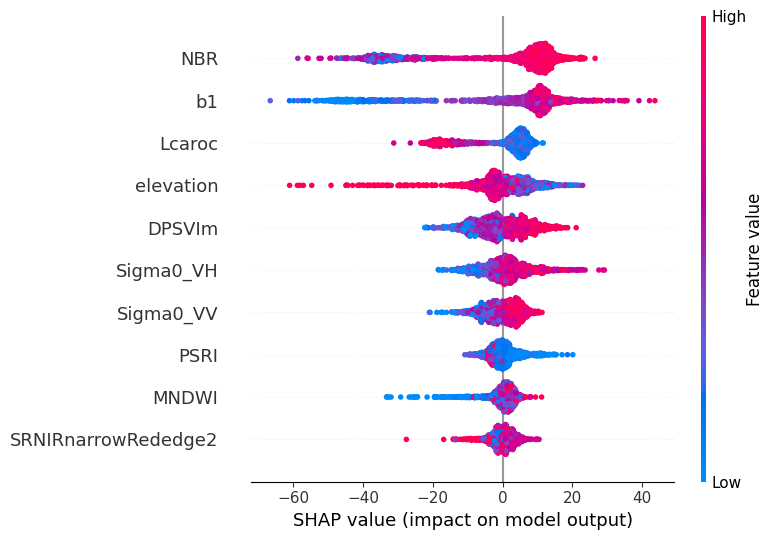

In [ ]:
# summarize plot which shoes the effects of all the features on model output
shap.summary_plot(shap_values_rf,rf_X)

## XGBoost (XGB)

In [ ]:
# in this example we initialize an XGB model
model_xgb = xgboost.XGBRegressor(random_state=42)
model_xgb.fit(xgb_X, y.values.flatten())

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [ ]:
explainer_xgb = shap.TreeExplainer(model_xgb)
shap_values_xgb = explainer_xgb.shap_values(xgb_X)

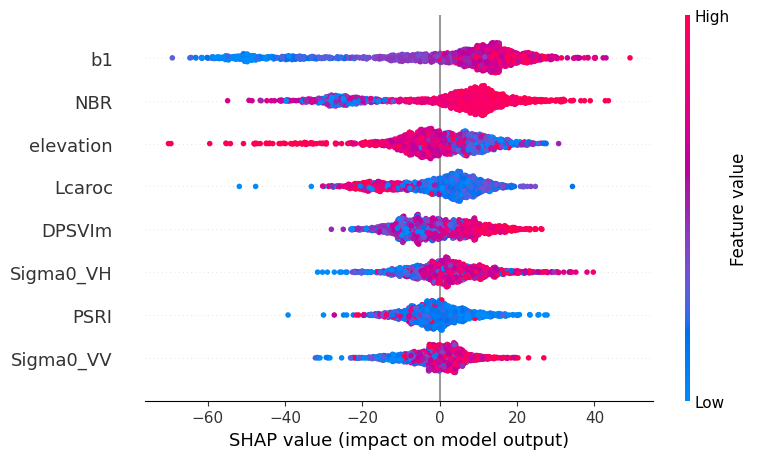

In [ ]:
# summarize plot which shoes the effects of all the features on model output
shap.summary_plot(shap_values_xgb, xgb_X)

## Deep Neural Network (DNN)

In [ ]:
dnn_X.shape[1],

(22,)

In [ ]:
# Initialize SHAP
shap.initjs()

# Create a deep learning model (similar to the one created earlier)
model_dnn = Sequential([
    Input(shape=(dnn_X.shape[1],)),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dropout(0.1),
    Dense(16, activation='relu'),
    Dense(8, activation='relu'),
    Dense(1, activation='linear')
])

# Compile the model
model_dnn.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model_dnn.fit(dnn_X, y, epochs=10, verbose=0)

TypeError: only integer scalar arrays can be converted to a scalar index

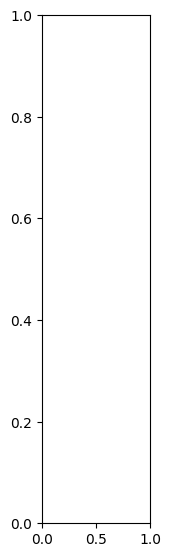

In [ ]:
# Criar o explicador SHAP usando DeepExplainer
explainer_dnn = shap.DeepExplainer(model_dnn, dnn_X.values) # Pass the underlying NumPy array

# Calcular os valores SHAP para as amostras de entrada
shap_values_dnn = explainer_dnn.shap_values(dnn_X.values) # Pass the underlying NumPy array

# Se shap_values_dnn for uma lista (DeepExplainer retorna uma lista no caso de redes neurais)
if isinstance(shap_values_dnn, list):
    shap_values_dnn = shap_values_dnn[0]

# Visualizar os valores SHAP com o gráfico de resumo (summary plot)
# Provide feature_names explicitly
shap.summary_plot(shap_values_dnn, dnn_X, feature_names=dnn_X.columns.tolist())

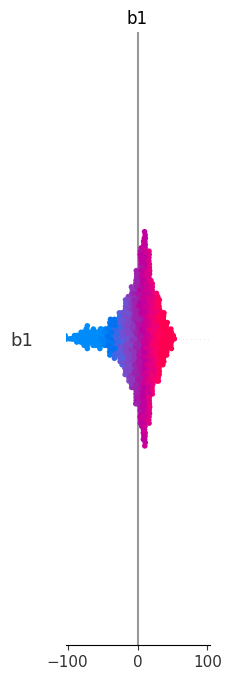

In [ ]:
# Use GradientExplainer to explain the deep learning model
explainer_dnn_2 = shap.GradientExplainer(model_dnn, dnn_X)

# Compute SHAP values for the training set
shap_values_dnn_2 = explainer_dnn_2.shap_values(dnn_X.values)

# Plot the SHAP summary plot to visualize the feature importance and their effect on the output
shap.summary_plot(shap_values_dnn_2, dnn_X, feature_names=X.columns)

# Above Ground Biomass Mapping (Google Earth Engine)

## Random Forest

In [ ]:
# Amostragem das variáveis preditoras
samples_gee = image_s2_s1_b1.sampleRegions(
  collection= extract_sentinel1,
  scale= 100,
  geometries=True
  # 'properties': ['AGB']
);

samples_gee

In [ ]:

# Fatiar as amostras
# Split train and test
samples_gee = samples_gee.randomColumn(seed=42);  # Adiciona uma coluna aleatória para ajudar na divisão dos dados em conjuntos de treino e teste.

train = samples_gee.filter(ee.Filter.lte('random', 0.7));  # Cria o conjunto de treino selecionando 70% dos dados (valores onde a coluna aleatória é menor ou igual a 0.7).
test = samples_gee.filter(ee.Filter.gt('random', 0.7));  # Cria o conjunto de teste com os 30% restantes dos dados (valores onde a coluna aleatória é maior que 0.7).

# # # Definição das variáveis (bandas e elevação) a serem utilizadas na análise.
# variables = ['b1', 'EVI', 'MNDWI', 'NBR', 'NDMI', 'NDVI','NDWI','SAVI','elevation','gNDVI',
#         'NDVIre',
#         'SRBlueRededge1',
#         'SRNIRnarrowRededge1',
#         'SRNIRnarrowRededge2',
#         'PSSRa',
#         'GCI',
#         'Lcaroc',
#         'Lchloc',
#         'PSRI',
#         'LAI',
#         'Sigma0_VV',
#         'Sigma0_VH',
#         'DPSVIm',yp
#         'DPSVIo',
#         'SARVI',
#         'razaoVVVH',
#         'NDSI'
#              ]

variables = ['b1','NBR','Sigma0_VH','elevation','DPSVIm','Sigma0_VV','Lcaroc','PSRI','MNDWI','SRNIRnarrowRededge2']

## Criando modelo para análise
model = ee.Classifier.smileRandomForest(numberOfTrees=628,
                                        variablesPerSplit=10,
                                        minLeafPopulation=1,
                                        maxNodes=150,
                                        seed=42).train(train, 'AGB', variables).setOutputMode('REGRESSION');  # Cria e treina um modelo de floresta aleatória com 100 árvores, usando as variáveis definidas e configurando o modo de saída para regressão.

print(model.explain().getInfo());  # Imprime informações sobre o modelo treinado para análise e compreensão.



{'importance': {'DPSVIm': 9165519415.543936, 'Lcaroc': 8487233566.21377, 'MNDWI': 9927644403.186178, 'NBR': 15555598105.555498, 'PSRI': 7838072204.177728, 'SRNIRnarrowRededge2': 6236781178.746634, 'Sigma0_VH': 10092507343.2349, 'Sigma0_VV': 6988152149.552233, 'b1': 11769352915.615366, 'elevation': 14153008975.352139}, 'numberOfTrees': 628, 'outOfBagErrorEstimate': 37.77985970805918, 'trees': ['n= 548\nnode), split, n, loss, yval, (yprob)\n* denotes terminal node\n1) root 548 1.3214e+07 0 \n 2) Lcaroc<=-4.90816 438 1.2919e+07 0 \n  4) NBR<=0.596591 43 6.5839e+05 0 \n   8) b1<=19.5000 28 3.4260e+05 0 \n    16) NBR<=0.491930 2 0.0000 53.0 *\n    17) NBR>0.491930 26 3.4308e+05 0 \n     34) SRNIRnarrowRededge2<=1.41194 15 1.5931e+05 0 \n      68) NBR<=0.552072 7 1.0938e+05 124.0 *\n      69) NBR>0.552072 8 52916 80.375 *\n     35) SRNIRnarrowRededge2>1.41194 11 1.9333e+05 0 \n      70) Sigma0_VH<=0.0174524 3 0.0000 107.33333333333333 *\n      71) Sigma0_VH>0.0174524 8 1.6062e+05 0 \n       

In [ ]:
# Verificando a importância de cada banda
variable_importance = ee.Feature(None, ee.Dictionary(model.explain().getInfo()).get('importance'));
variable_importance.getInfo()

In [ ]:
# Convertendo dados para uma lista
lista_variable_importance = ee.List(variable_importance).getInfo()
# Criando dataframe da importância das variáveis
variable_importance_df = pd.DataFrame(lista_variable_importance, columns=['properties',])
variable_importance_df =variable_importance_df.sort_values(by='properties', ascending=False)
variable_importance_df.round(2).reset_index()

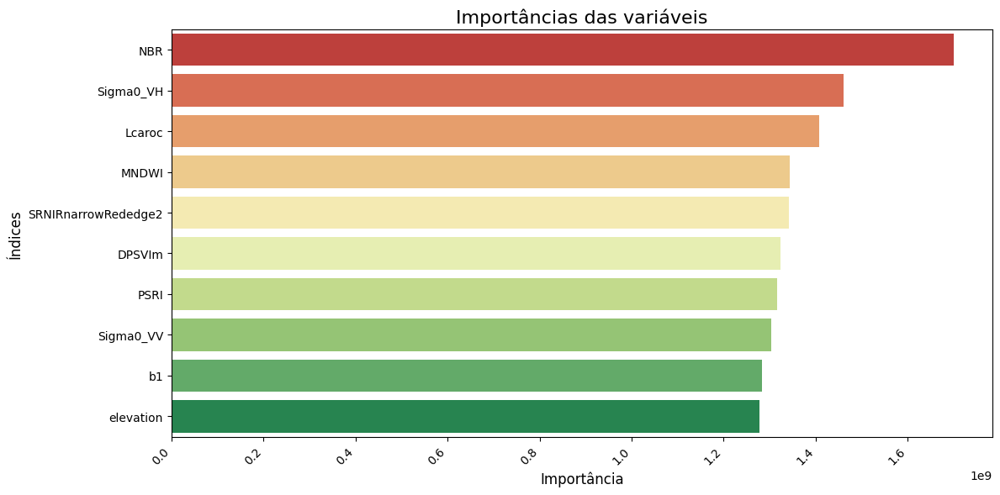

In [ ]:
# Configurando o tamanho do gráfico
plt.figure(figsize=(12, 6))

# Criação do gráfico de barras
ax1 = sns.barplot(x='properties', y="index", data=variable_importance_df.reset_index(), palette='RdYlGn')

# Ajuste dos rótulos do eixo x para melhor legibilidade
plt.xticks(rotation=45, ha='right')  # Rotaciona os rótulos e alinha-os à direita para melhor visualização

# Definição dos rótulos e título com fontes maiores para melhor legibilidade
plt.xlabel("Importância", fontsize=12)
plt.ylabel("Índices", fontsize=12)
plt.title("Importâncias das variáveis", fontsize=16)

# Exibindo o gráfico
plt.tight_layout()  # Ajusta o layout para evitar sobreposição de elementos
plt.show()

In [ ]:
# Classificar os dados de teste
sample_test = test.classify(model, 'prediction').map(lambda feat:
    feat.set('residual', ee.Number(feat.get('AGB')).subtract(ee.Number(feat.get('prediction'))).pow(2))) # Corrigido para calcular o quadrado dos resíduos

# O resultado final sample_test é um conjunto de dados de teste com duas
# novas colunas adicionadas: 'prediction', que contém os valores previstos pelo modelo, e 'residual',
# que contém os resíduos (diferença ao quadrado) entre os valores observados e previstos.
sample_test  # Objeto contendo os dados de teste classificados e os resíduos calculados.

# Obter a média dos valores reais de AGB
meanAGB = sample_test.aggregate_mean('AGB')

# Usar map para calcular a diferença ao quadrado de cada valor de AGB em relação à média
SST_calculation = sample_test.map(lambda feat: ee.Feature(None, {'sst': ee.Number(feat.get('AGB')).subtract(meanAGB).pow(2)}))

# Calcular a SST somando todos os valores de sst
SST = SST_calculation.aggregate_sum('sst')

# Calcular a SSR (soma dos quadrados dos resíduos)
SSR = sample_test.aggregate_sum('residual')

# Calcular o R^2
R2 = ee.Number(1).subtract(SSR.divide(SST))

# Imprimir o R^2 (pode precisar ser convertido para um valor numérico no cliente, dependendo do seu ambiente)
print('R²:', R2.getInfo())

# # Calcular o MSE, que é uma medida da qualidade das previsões.
# mse = mean_squared_error(sample_test, 'prediction')
# rmse = np.sqrt(mse)

# Get the predicted and actual values as NumPy arrays
y_true = np.array(sample_test.aggregate_array('AGB').getInfo()) # Extract the 'AGB' values (true values)
y_pred = np.array(sample_test.aggregate_array('prediction').getInfo()) # Extract the 'prediction' values (predicted values)

# Calculate the MSE using the NumPy arrays
mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_true, y_pred)

# print('MSE:', mse)
print('RMSE:', rmse)
print('MAE:', mae)

R²: 0.6537995157821967
RMSE: 37.996581243000016
MAE: 30.215213516132746


In [ ]:
# Classificar os dados de teste
sample_test = test.classify(model, 'prediction').map(lambda feat:
    feat.set('residual', ee.Number(feat.get('AGB')).subtract(ee.Number(feat.get('prediction'))).pow(2))) # Corrigido para calcular o quadrado dos resíduos

# O resultado final sample_test é um conjunto de dados de teste com duas
# novas colunas adicionadas: 'prediction', que contém os valores previstos pelo modelo, e 'residual',
# que contém os resíduos (diferença ao quadrado) entre os valores observados e previstos.
sample_test  # Objeto contendo os dados de teste classificados e os resíduos calculados.

# Obter a média dos valores reais de AGB
meanAGB = sample_test.aggregate_mean('AGB')

# Usar map para calcular a diferença ao quadrado de cada valor de AGB em relação à média
SST_calculation = sample_test.map(lambda feat: ee.Feature(None, {'sst': ee.Number(feat.get('AGB')).subtract(meanAGB).pow(2)}))

# Calcular a SST somando todos os valores de sst
SST = SST_calculation.aggregate_sum('sst')

# Calcular a SSR (soma dos quadrados dos resíduos)
SSR = sample_test.aggregate_sum('residual')

# Calcular o R^2
R2 = ee.Number(1).subtract(SSR.divide(SST))

# Imprimir o R^2 (pode precisar ser convertido para um valor numérico no cliente, dependendo do seu ambiente)
print('R²:', R2.getInfo())

# # Calcular o MSE, que é uma medida da qualidade das previsões.
# mse = mean_squared_error(sample_test, 'prediction')
# rmse = np.sqrt(mse)

# Get the predicted and actual values as NumPy arrays
y_true = np.array(sample_test.aggregate_array('AGB').getInfo()) # Extract the 'AGB' values (true values)
y_pred = np.array(sample_test.aggregate_array('prediction').getInfo()) # Extract the 'prediction' values (predicted values)

# Calculate the MSE using the NumPy arrays
mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_true, y_pred)

# print('MSE:', mse)
print('RMSE:', rmse)
print('MAE:', mae)

R²: 0.5923695950306187
RMSE: 41.00381308609265
MAE: 32.89544722106074


In [ ]:
# Nome das bandas
labels_predict = ['AGB','b1', 'EVI', 'MNDWI', 'NBR', 'NDMI', 'NDVI','NDWI','SAVI','elevation','gNDVI',
        'NDVIre',
        'SRBlueRededge1',
        'SRNIRnarrowRededge1',
        'SRNIRnarrowRededge2',
        'PSSRa',
        'GCI',
        'Lcaroc',
        'Lchloc',
        'PSRI',
        'LAI',
        'Sigma0_VV',
        'Sigma0_VH',
        'DPSVIm',
        'DPSVIo',
        'SARVI',
        'razaoVVVH',
        'NDSI',
        'prediction', 'random',
        'residual']

# Crie uma lista com os dados da malha amostra que você criou
Lista_df_predict = sample_test.reduceColumns(ee.Reducer.toList(31), labels_predict).values().get(0)
# Visualize seu dataframe no utilizando os pandas
df_predict = pd.DataFrame(Lista_df_predict.getInfo(), columns=labels_predict)
df_predict

,AGB,b1,EVI,MNDWI,NBR,NDMI,NDVI,NDWI,SAVI,elevation,...,Sigma0_VV,Sigma0_VH,DPSVIm,DPSVIo,SARVI,razaoVVVH,NDSI,prediction,random,residual
0,44,17,0.530732,-0.509823,0.589093,0.308231,0.793811,-0.720383,0.505322,0.627476,...,0.037532,0.005486,0.001178,0.000346,0.178366,5.950864,-0.121895,127.608573,0.974522,6990.393533
1,46,19,0.406129,-0.528091,0.546230,0.269620,0.777605,-0.708709,0.412831,0.627099,...,0.049290,0.008607,0.002057,0.000449,0.182493,5.790218,-0.108482,134.409662,0.859856,7816.268320
2,68,14,0.593801,-0.559875,0.646756,0.349455,0.859654,-0.763449,0.563049,0.624611,...,0.066137,0.014268,0.003741,0.000666,0.235785,4.565714,-0.131452,114.140286,0.783848,2128.926017
3,196,15,0.624118,-0.524993,0.627910,0.341527,0.844501,-0.736810,0.569672,0.642325,...,0.072551,0.016569,0.004552,0.000716,0.245982,4.316397,-0.140019,135.690577,0.945594,3637.226516
4,120,21,0.514881,-0.575620,0.670875,0.374341,0.877951,-0.785370,0.504159,0.639024,...,0.080096,0.018017,0.005644,0.000751,0.252102,4.324578,-0.138408,154.167545,0.919888,1167.421154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
439,182,20,0.582456,-0.608610,0.701849,0.399534,0.903521,-0.811275,0.554280,0.676734,...,0.093165,0.020967,0.007546,0.000713,0.244918,4.457083,-0.108818,185.131463,0.756303,9.806060
440,75,16,0.528924,-0.592707,0.634785,0.318404,0.868021,-0.765204,0.511777,0.690475,...,0.088773,0.019615,0.006742,0.000681,0.245784,4.439228,-0.114281,124.684886,0.884389,2468.587945
441,45,16,0.505842,-0.566865,0.516502,0.244279,0.775861,-0.706425,0.486421,0.691869,...,0.083916,0.019297,0.006080,0.000744,0.248439,4.336331,-0.123149,70.380845,0.852433,644.187308
442,71,16,0.523523,-0.596630,0.586775,0.289613,0.830476,-0.752416,0.505856,0.693537,...,0.086142,0.019835,0.006450,0.000754,0.252111,4.321175,-0.125739,91.870393,0.825397,435.573314


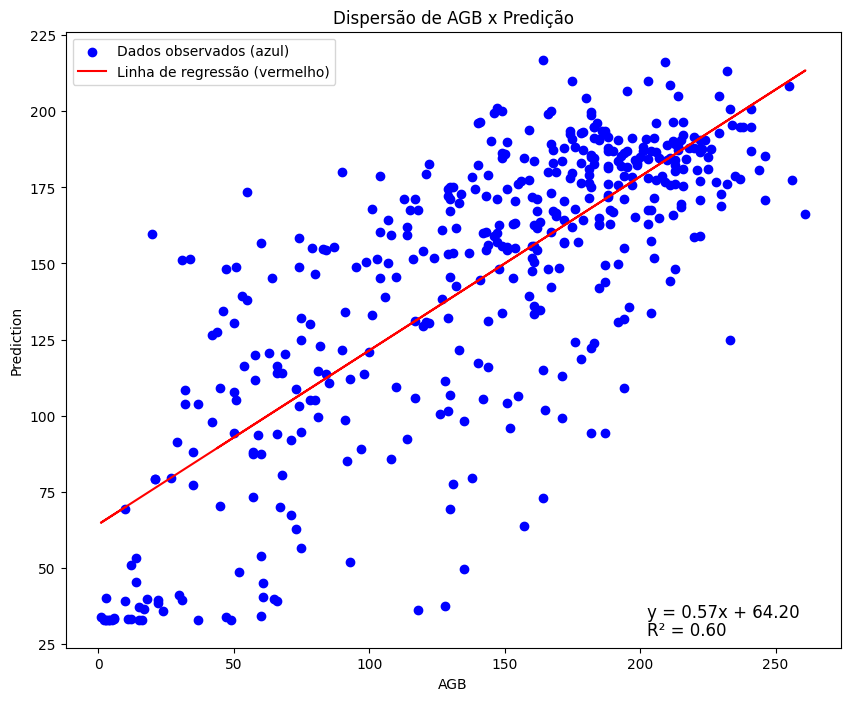

In [ ]:
# Modelo de regressão linear
X_df = df_predict[['AGB']]
y_df = df_predict['prediction']
modelo = LinearRegression().fit(X_df, y_df)

# Calculando a equação e R^2
slope = modelo.coef_[0]
intercept = modelo.intercept_
r_squared = r2_score(y_df, modelo.predict(X_df))
equation = f"y = {slope:.2f}x + {intercept:.2f}"
r2_text = f"R² = {r_squared:.2f}"

# Configurando o tamanho do gráfico
plt.figure(figsize=(10, 8))

# Gerando o gráfico de dispersão
plt.scatter(df_predict['AGB'], df_predict['prediction'], color='blue', label='Dados observados (azul)')
plt.plot(df_predict['AGB'], modelo.predict(X_df), color='red', label='Linha de regressão (vermelho)')

# Adicionando título e rótulos
plt.title('Dispersão de AGB x Predição')
plt.xlabel('AGB')
plt.ylabel('Prediction')

# Adicionando a legenda
plt.legend()

# Posicionamento do texto da equação e R^2 na parte inferior do gráfico
plt.text(0.75, 0.05, equation, transform=plt.gca().transAxes, fontsize=12)
plt.text(0.75, 0.02, r2_text, transform=plt.gca().transAxes, fontsize=12)

# Mostrando o gráfico
plt.show()

In [ ]:
# Plotar gráfico de dispersão dos resíduos

In [ ]:
# Show the AGB prediction
agbPrediction = image_s2_s1_b1.classify(model, 'AGB');
vis_params = {'bands': ['AGB'], 'palette': ['#a50026', '#a70226', '#a90426', '#ab0626', '#ad0826', '#af0926', '#b10b26', '#b30d26', '#b50f26',
                                            '#b71126', '#b91326', '#bb1526', '#bd1726', '#be1827', '#c01a27', '#c21c27', '#c41e27', '#c62027',
                                            '#c82227', '#ca2427', '#cc2627', '#ce2827', '#d02927', '#d22b27', '#d42d27', '#d62f27', '#d83128',
                                            '#d93429', '#da362a', '#db382b', '#dc3b2c', '#dd3d2d', '#de402e', '#e0422f', '#e14430', '#e24731',
                                            '#e34933', '#e44c34', '#e54e35', '#e65036', '#e75337', '#e95538', '#ea5739', '#eb5a3a', '#ec5c3b',
                                            '#ed5f3c', '#ee613e', '#ef633f', '#f16640', '#f26841', '#f36b42', '#f46d43', '#f47044', '#f57245',
                                            '#f57547', '#f57748', '#f67a49', '#f67c4a', '#f67f4b', '#f7814c', '#f7844e', '#f8864f', '#f88950',
                                            '#f88c51', '#f98e52', '#f99153', '#f99355', '#fa9656', '#fa9857', '#fa9b58', '#fb9d59', '#fba05b',
                                            '#fba35c', '#fca55d', '#fca85e', '#fcaa5f', '#fdad60', '#fdaf62', '#fdb163', '#fdb365', '#fdb567',
                                            '#fdb768', '#fdb96a', '#fdbb6c', '#fdbd6d', '#fdbf6f', '#fdc171', '#fdc372', '#fdc574', '#fdc776',
                                            '#fec877', '#feca79', '#fecc7b', '#fece7c', '#fed07e', '#fed27f', '#fed481', '#fed683', '#fed884',
                                            '#feda86', '#fedc88', '#fede89', '#fee08b', '#fee18d', '#fee28f', '#fee491', '#fee593', '#fee695',
                                            '#fee797', '#fee999', '#feea9b', '#feeb9d', '#feec9f', '#feeda1', '#feefa3', '#fff0a6', '#fff1a8',
                                            '#fff2aa', '#fff3ac', '#fff5ae', '#fff6b0', '#fff7b2', '#fff8b4', '#fffab6', '#fffbb8', '#fffcba',
                                            '#fffdbc', '#fffebe', '#feffbe', '#fdfebc', '#fbfdba', '#fafdb8', '#f8fcb6', '#f7fcb4', '#f5fbb2',
                                            '#f4fab0', '#f2faae', '#f1f9ac', '#eff8aa', '#eef8a8', '#ecf7a6', '#ebf7a3', '#e9f6a1', '#e8f59f',
                                            '#e6f59d', '#e5f49b', '#e3f399', '#e2f397', '#e0f295', '#dff293', '#ddf191', '#dcf08f', '#daf08d',
                                            '#d9ef8b', '#d7ee8a', '#d5ed88', '#d3ec87', '#d1ec86', '#cfeb85', '#cdea83', '#cbe982', '#c9e881',
                                            '#c7e77f', '#c5e67e', '#c3e67d', '#c1e57b', '#bfe47a', '#bde379', '#bbe278', '#b9e176', '#b7e075',
                                            '#b5df74', '#b3df72', '#b1de71', '#afdd70', '#addc6f', '#abdb6d', '#a9da6c', '#a7d96b', '#a5d86a',
                                            '#a2d76a', '#a0d669', '#9dd569', '#9bd469', '#98d368', '#96d268', '#93d168', '#91d068', '#8ecf67',
                                            '#8ccd67', '#89cc67', '#87cb67', '#84ca66', '#82c966', '#7fc866', '#7dc765', '#7ac665', '#78c565',
                                            '#75c465', '#73c264', '#70c164', '#6ec064', '#6bbf64', '#69be63', '#66bd63', '#63bc62', '#60ba62',
                                            '#5db961', '#5ab760', '#57b65f', '#54b45f', '#51b35e', '#4eb15d', '#4bb05c', '#48ae5c', '#45ad5b',
                                            '#42ac5a', '#3faa59', '#3ca959', '#39a758', '#36a657', '#33a456', '#30a356', '#2da155', '#2aa054',
                                            '#279f53', '#249d53', '#219c52', '#1e9a51', '#1b9950', '#199750', '#18954f', '#17934e', '#16914d',
                                            '#15904c', '#148e4b', '#138c4a', '#128a49', '#118848', '#108647', '#0f8446', '#0e8245', '#0d8044',
                                            '#0c7f43', '#0b7d42', '#0a7b41', '#097940', '#08773f', '#07753e', '#06733d', '#05713c', '#04703b',
                                            '#036e3a', '#026c39', '#016a38', '#006837'],
                                            'min': 32.89748490734435, 'max': 218.29777070063705}

Map.addLayer(agbPrediction, vis_params, 'AGB Prediction')
Map.centerObject(region,11)



# Display the map with the legend
Map.add_legend(legend)
Map

Map(bottom=301507.0, center=[-25.893377156799872, -52.325960071094045], controls=(WidgetControl(options=['posi…

In [ ]:
# Calcular a média de AGB (t/ha) na área de estudo usando estatísticas zonais
mean_biomass_predicted = agbPrediction.reduceRegion(**{
    'reducer': ee.Reducer.mean(),
    'geometry': region,
    'scale': 100,  # Escala apropriada para o dataset (100m)
    'maxPixels': 1e13,
    'bestEffort': True
})

# Obter o valor médio de biomassa (t/ha) da área de estudo
mean_biomass_value_predicted = mean_biomass_predicted.get('AGB').getInfo()

# Imprimir o valor médio de biomassa (t/ha)
print(f'Mean Biomass Predicted (t/ha) in study area: {mean_biomass_value_predicted}')

# Comparar com o valor do inventário florestal
biomass_inventory = 151  # Valor do inventário florestal

# Imprimir a comparação
difference = mean_biomass_value_predicted - biomass_inventory
print(f'Difference between GEE and inventory biomass (t/ha): {difference}')

Mean Biomass Predicted (t/ha) in study area: 142.33637104692428
Difference between GEE and inventory biomass (t/ha): -8.663628953075715


In [ ]:
##Exportar o melhor modelo (gerado aleatóriamente)
df_predict.to_csv('/content/drive/MyDrive/TCC_MBA/pred_rf.csv')